In [63]:
import pandas as pd
import numpy as np
import yaml
from sklearn.manifold import TSNE
from sklearn.cluster import DBSCAN
from scipy.fft import fft
from scipy.stats import boxcox
from scipy.special import inv_boxcox
import matplotlib.pyplot as plt
from plotly.subplots import make_subplots
from sklearn.preprocessing import StandardScaler, OneHotEncoder, LabelEncoder, MinMaxScaler, PowerTransformer, RobustScaler
from sklearn.linear_model import LinearRegression
import openpyxl
import plotly.graph_objects as go
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, recall_score,precision_score, f1_score, mean_squared_error
from sklearn.metrics import average_precision_score
import xgboost as xgb
from xgboost.callback import TrainingCallback
import optuna
import talib
import json
import pickle
import torch
import os
import logging
from scipy.stats.mstats import winsorize
from plotly.subplots import make_subplots
import seaborn as sns
from imblearn.over_sampling import SMOTEN
import smogn
import warnings
from datetime import datetime, timedelta
from sklearn.utils import resample


In [2]:
print(torch.backends.mps.is_available())

False


In [3]:
def load_yaml(file):
    import yaml
    with open(file, 'r') as f:
        config = yaml.safe_load(f)
    return config
    



In [4]:
config = load_yaml('../config_xgRegSlope.yaml')

In [5]:
for handler in logging.root.handlers[:]:
    logging.root.removeHandler(handler)

log_dir = "logs"
os.makedirs(log_dir, exist_ok=True)
log_file = "logstraining_logs_xgClass_AUC_1minute.txt"
log_file_path = os.path.join(log_dir, log_file)
print(log_file_path)
logging.basicConfig(
    filename=log_file_path,
    level=logging.INFO,
    format="%(asctime)s - %(levelname)s - %(message)s",
    datefmt="%Y-%m-%d %H:%M:%S"
)

logging.info("Logging started")

logs\logstraining_logs_xgClass_AUC_1minute.txt


In [6]:
all_trading_data_dfs = []
sheet_names = ['1minData1-6-2022', '1minData1-12-2023', '1minData1-22-2024']
for sheet in sheet_names:
    temp_df = pd.read_excel(config['all_data_excel_path'], sheet_name=sheet)
    all_trading_data_dfs.append(temp_df)
all_trading_data = pd.concat(all_trading_data_dfs, ignore_index=True)

# Load 5 min data
all_trading_data['Date'] = pd.to_datetime(all_trading_data['Date'])

In [7]:
##### Set the Date Start and End for the filtering of trading data
train_start_date = pd.to_datetime('2023-01-01')
train_end_date = pd.to_datetime('2023-12-31')
trading_data_raw = all_trading_data[(all_trading_data['Date'] >= train_start_date) & (all_trading_data['Date'] <= train_end_date)]
trading_data_raw = trading_data_raw.reset_index(drop=True)
trading_data_raw.drop(columns=['Symbol'], inplace=True)
trading_data_raw.info() 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 97532 entries, 0 to 97531
Data columns (total 6 columns):
 #   Column  Non-Null Count  Dtype         
---  ------  --------------  -----         
 0   Date    97532 non-null  datetime64[ns]
 1   Open    97532 non-null  float64       
 2   High    97532 non-null  float64       
 3   Low     97532 non-null  float64       
 4   Close   97532 non-null  float64       
 5   Volume  97532 non-null  int64         
dtypes: datetime64[ns](1), float64(4), int64(1)
memory usage: 4.5 MB


In [8]:
fourier_lookback_window = config['fourier_lookback_window']
fourier_n_components = config['fourier_n_components']
m_bars = config['m_future']

In [9]:
def calculate_bollinger_bands(data, window_size, num_std_dev):
    rolling_mean = data['Close'].rolling(window=window_size).mean()
    rolling_std = data['Close'].rolling(window=window_size).std()
    data['BOLLBU'] = rolling_mean + (rolling_std * num_std_dev)
    data['BOLLBM'] = rolling_mean
    data['BOLLBL'] = rolling_mean - (rolling_std * num_std_dev)
    
    return data

def calculate_donchn_bands(data, window_size):
    data['DONCH_U'] = data['High'].rolling(window=window_size).max()
    data['DONCH_L'] = data['Low'].rolling(window=window_size).min()
    
    return data
    
def calculate_tchr(data):
    period = config['tchr_period']
    retracement = config['tchr_retracement']
    adj = config['tchr_adj']
    range = config['tchr_range']

    if range == 'highlow':
        data['TCHR_U'] = talib.MAX(data['High'], timeperiod=period) + adj
        data['TCHR_L'] = talib.MIN(data['Low'], timeperiod=period) - adj
    elif range == 'close':
        data['TCHR_U'] = talib.MAX(data['Close'], timeperiod=period) + adj
        data['TCHR_L'] = talib.MIN(data['Close'], timeperiod=period) - adj
    
    #calculate retracement
    if retracement == "long":
        data['TCHR'] = (data['Close'] - data['TCHR_L']) / (data['TCHR_U'] - data['TCHR_L'])
    elif retracement == "short":
        data['TCHR'] = (data['TCHR_U'] - data['Close']) / (data['TCHR_U'] - data['TCHR_L'])
    
    return data
    
def calculate_adwm(data):
    period = config['adwm_period']
    data['Previous_Close']= data['Close'].shift(1)
    data['TRH'] = data[['High', 'Previous_Close']].max(axis=1)
    data['TRL'] = data[['Low', 'Previous_Close']].min(axis=1)

    data['ADWM_AD'] = 0.0
    data.loc[data['Close'] > data['Previous_Close'], 'ADWM_AD'] = (data['Close'] - data['TRL'])
    data.loc[data['Close'] < data['Previous_Close'], 'ADWM_AD'] = (data['Close'] - data['TRH'])

    data['ADWM'] = data['ADWM_AD']

    data['ADWMMA'] = data['ADWM'].rolling(window=period).mean()

    return data

def calculate_si(row, prev_row, limit):
    if pd.isna(prev_row['Close']):
        return 0
    c = row['Close']
    c_prev = prev_row['Close']
    o = row['Open']
    o_prev = prev_row['Open']
    return (50 * ((c - c_prev) + (0.5 * (c - o)) + (0.25 * (c_prev - o_prev))) / limit)

def calculate_WASI(data):
    wasi_limit = config['wasi_limit']
    data['SI'] = data.apply(lambda row: calculate_si(row, data.shift(1).loc[row.name], wasi_limit), axis=1)
    data['WASI'] = data['SI']
    return data

def calculate_ATR(data):
    atr_period = config['atr_period']
    atr_ma = config['atr_ma']
    data['ATR'] = talib.ATR(data['High'], data['Low'], data['Close'], timeperiod=atr_period)
    data['ADJATR'] = talib.SMA(data['ATR'], timeperiod=atr_ma)
    return data


def compute_volatility_momentum(df, price_col='Close', vol_window=14, mom_window=10):
    """
    Computes rolling volatility and momentum for a given price column.

    Parameters:
        df (pd.DataFrame): DataFrame containing historical price data.
        price_col (str): Column name of the closing price.
        vol_window (int): Window size for rolling volatility calculation.
        mom_window (int): Window size for momentum calculation.

    Returns:
        pd.DataFrame: DataFrame with added 'Volatility' and 'Momentum' features.
    """

    # Ensure price column exists
    if price_col not in df.columns:
        raise ValueError(f"Column '{price_col}' not found in DataFrame")

    # 🔹 Compute Log Returns (for better volatility calculation)
    df['Log_Returns'] = np.log(df[price_col] / df[price_col].shift(1))

    # 🔹 Compute Rolling Volatility (Standard Deviation of Log Returns)
    df['Volatility'] = df['Log_Returns'].rolling(window=vol_window).std()

    # 🔹 Compute Momentum (Rate of Change in Price)
    df['Momentum'] = df[price_col].pct_change(periods=mom_window) * 100

    # 🔹 Drop NaN values from rolling computations
    #df.dropna(inplace=True)

    return df


def compute_fourier_df(value_series, n_components=10):
    fft_result = np.fft.fft(value_series)
    real = fft_result.real[:n_components]
    imag = fft_result.imag[:n_components]
    mag = np.abs(fft_result)[:n_components]

    return real, imag, mag

def get_fourier_columns():
    return [f'fourier_real_{j+2}' for j in range(fourier_n_components-1)] + [f'fourier_imag_{j+2}' for j in range(fourier_n_components-1)] + [f'fourier_mag_{j+2}' for j in range(fourier_n_components-1)]   

def transform_features(df):
    close_diff_features = config['Close_Diff_Features'].split(',')
    df[close_diff_features] = df[close_diff_features].sub(df['Close'], axis=0).div(df['Close'], axis=0)
    return df

def get_all_training_features():
    training_features = config['training_features'].split(',')
    fourier_cols = get_fourier_columns()
    return training_features + fourier_cols

def normalize_timegaps(df, time_gap_threshold=300):
    df = df.copy()
    features = ['Open', 'High', 'Low', 'Close']
    df['time_delta'] = df['Date'].diff().dt.total_seconds()
    df['time_delta'] = df['time_delta'].fillna(df['time_delta'].median())
    df['time_gap_flag'] = df['time_delta'] > time_gap_threshold
    gap_indices = df.index[df['time_gap_flag']].tolist()
    for p in gap_indices:
        if p > 0: # ensure p-1 exist
            jump_value = df.loc[p, 'Close'] - df.loc[p-1, 'Close']
            df.loc[:p-1, features] += jump_value
    return df

In [10]:
def add_new_features_df(data):
    fourier_lookback_window = config['fourier_lookback_window']
    fourier_n_components = config['fourier_n_components']

    #data['Date'] = pd.to_datetime(data['Date'])
    #print(f"bolband period : {config['bolband_period']}")
    bolband_period = config['bolband_period']
    bolband_width = config['bolband_width']
    upper, middle, lower = talib.BBANDS(data['Close'], timeperiod=bolband_period, nbdevup=bolband_width, nbdevdn=bolband_width, matype=0)
    data['BOLLBU'] = upper
    data['BOLLBM'] = middle
    data['BOLLBL'] = lower
    #data = calculate_bollinger_bands(data, int(config['bolband_period']), int(config['bolband_width']))

    # Calculate DONCHN Bands
    donchn_period = config['donchn_period']
    data['DONUP'] = talib.MAX(data['High'], timeperiod=donchn_period)

    data['DONLOW'] = talib.MIN(data['Low'], timeperiod=donchn_period)

    data['DONMID'] = (data['DONLOW'] + data['DONUP']) / 2

    data['MA20'] = talib.SMA(data['Close'], timeperiod=20)

    data['MA50'] = talib.SMA(data['Close'], timeperiod=50)

    data['MA100'] = talib.SMA(data['Close'], timeperiod=100)

    data['EMA20'] = talib.EMA(data['Close'], timeperiod=20)

    # Calculate the pivot points
    data['PVPT'] = (data['High'] + data['Low'] + data['Close']) / 3
    data['PVPTR1'] = (2 * data['PVPT']) - data['Low']

    data['PVPTR2'] = data['PVPT'] + data['High'] - data['Low']

    data['PVPTR3'] = data['High'] + 2 * (data['PVPT'] - data['Low'])

    data['PVPTS1'] = (2 * data['PVPT']) - data['High']

    data['PVPTS2'] = data['PVPT'] - (data['High'] - data['Low'])

    data['PVPTS3'] = data['Low'] - 2 * (data['High'] - data['PVPT'])

    data = calculate_tchr(data)

    data = calculate_adwm(data)

    data = calculate_WASI(data)

    volume_ma_period = config['volume_ma_period']

    data['VOLMA'] = talib.SMA(data['Volume'], timeperiod=volume_ma_period)

    data = calculate_ATR(data)

    data['DayofWeek'] = data['Date'].dt.dayofweek

    data['DayofWeek'] = data['DayofWeek'].astype('category')

    data = compute_volatility_momentum(data, price_col='Close', vol_window=config['volatility_period'], mom_window=config['momentum_period'])

    # Add fourier columns to the df
    for i in range(fourier_n_components):
        data[f'fourier_real_{i+1}'] = np.nan
        data[f'fourier_imag_{i+1}'] = np.nan
        data[f'fourier_mag_{i+1}'] = np.nan

    features = []
    epsilon = 1e-5
    #print(f"fourier window - 1 : {fourier_lookback_window - 1}")
    for i in range(len(data)):
        if i >= fourier_lookback_window - 1:
            #print("entered point 1")
            close_window = data['Close'].iloc[i - fourier_lookback_window + 1: i + 1].values
            real, imag, mag = compute_fourier_df(close_window, n_components=fourier_n_components)

            for j in range(fourier_n_components):
                data.iloc[i, data.columns.get_loc(f'fourier_real_{j+1}')] = real[j]
                data.iloc[i, data.columns.get_loc(f'fourier_imag_{j+1}')] = imag[j]
                data.iloc[i, data.columns.get_loc(f'fourier_mag_{j+1}')] = mag[j]
                #print(data.loc[i, 'Date'])
    


    # Add the time of day feature to the trading data

    # Define max time of day in minutes
    MAX_TIME_MINUTES = 1440
    data['Minutes_Passed'] = (data['Date'].dt.hour* 60) + data['Date'].dt.minute
    data['TimeOfDay_Group'] = (data['Minutes_Passed'] // 5).astype('int')
    data['Sine_TimeOfDay'] = np.sin(2 * np.pi * data['TimeOfDay_Group'] / MAX_TIME_MINUTES)
    data['Cosine_TimeOfDay'] = np.cos(2 * np.pi * data['TimeOfDay_Group'] / MAX_TIME_MINUTES)
    data['Take_Profit_Level'] = (data['Close'] * config['atr_multiplier'] * data['ADJATR'])
    data['time_delta'] = data['Date'].diff().dt.total_seconds()
    data['time_delta'].fillna(data['time_delta'].median(), inplace=True)
    #print("Feature df info : ")
    #print(data.info())

    #print(f"Last row after adding features : ")
    #print(data.tail())
    return data


In [11]:
trading_data_time_normalized = normalize_timegaps(trading_data_raw)

In [12]:
toplot_df = trading_data_time_normalized

fig = make_subplots(rows=2, cols=1, shared_xaxes=True, 
                    vertical_spacing=0.1,
                    subplot_titles=("CandleStick Chart Norm", "CandleStick Chart"))
fig.add_trace(
    go.Candlestick(
        x=toplot_df['Date'], 
        open=toplot_df['Open'], 
        high=toplot_df['High'], 
        low=toplot_df['Low'], 
        close=toplot_df['Close'],
        name='OHLC Norm'
        ), row=1, col=1
)

fig.add_trace(
    go.Candlestick(
        x=trading_data_raw['Date'], 
        open=trading_data_raw['Open'], 
        high=trading_data_raw['High'], 
        low=trading_data_raw['Low'], 
        close=trading_data_raw['Close'],
        name='OHLC'
        ), row=2,col=1
)

fig.update_layout(
    title='CandleStick chart of time normalized',
    xaxis=dict(type="date", 
               rangebreaks=[
                   dict(bounds=["sat", "mon"]),
                   dict(bounds=[16,9.5], pattern='hour')
               ]              
            ),
    xaxis_rangeslider_visible=False,
    height=600,
    hovermode='x unified'
)



fig.update_xaxes(matches='x')

fig.show()

In [13]:

def calculate_label(data):

# Define the threshold for buy and sell signals
    
    buy_powers = []
    sell_powers = []
    n=config['bars_no_to_wait']
    for i in range(len(data)):
        current_close = data.loc[i, "Close"]

        future_closes = data.loc[i+1: i+n+1, "Close"].values

        if len(future_closes) == 0:
            buy_powers.append(0)
            sell_powers.append(0)
            continue
        future_close_max = max(future_closes) 
        future_close_min = min(future_closes)
        max_high = future_close_max - current_close
        min_high = current_close - future_close_min
        max_high_idx = list(future_closes).index( future_close_max)
        min_high_idx = list(future_closes).index( future_close_min)

        if max_high_idx == (len(future_closes) - 1): #when max value is at the last of window
            buy_retr_penalty = 0
        else:
            buy_retr_penalty = future_close_max - min(future_closes[max_high_idx+1:])
        max_down_below = max(0, current_close - future_close_min)
        penalty_buy = buy_retr_penalty + max_down_below
        buy_power = max(0, max_high - penalty_buy)

        if min_high_idx == (len(future_closes) - 1): 
            sell_retr_penalty = 0
        else:
            sell_retr_penalty = max(future_closes[min_high_idx+1:]) - future_close_min
        max_up_above = max(0, future_close_max - current_close)
        penalty_sell = sell_retr_penalty + max_up_above
        sell_power = max(0, min_high - penalty_sell)

        buy_powers.append(buy_power)
        sell_powers.append(sell_power)

    data['BuyPower'] = buy_powers
    data['SellPower'] = sell_powers
        

    return data

In [14]:
trading_data_with_power = calculate_label(trading_data_time_normalized)
trading_data_with_power.dropna(inplace=True)

In [15]:
trading_data_with_power[['BuyPower']].describe()

,BuyPower
count,97532.000000
mean,0.141181
std,0.294040
min,0.000000
25%,0.000000
50%,0.000000
75%,0.165000
max,6.820000


In [16]:
trading_data_with_power[['SellPower']].describe()

,SellPower
count,97532.000000
mean,0.134642
std,0.308332
min,0.000000
25%,0.000000
50%,0.000000
75%,0.110000
max,4.890000


In [17]:
trading_data_with_power[(trading_data_with_power['BuyPower'] == 0) | (trading_data_with_power['SellPower'] == 0)].count()
#trading_data_with_slope.count()

Date             97532
Open             97532
High             97532
Low              97532
Close            97532
Volume           97532
time_delta       97532
time_gap_flag    97532
BuyPower         97532
SellPower        97532
dtype: int64

In [18]:
trading_data_with_features = add_new_features_df(trading_data_with_power.copy())

C:\Users\coool\AppData\Local\Temp\ipykernel_28540\1900632745.py:96: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.





In [32]:
##### Save to parquet file to load quickly next time
trading_data_with_features.to_parquet('../Parquet/trading_data_with_features_auc1min.parquet', index=False, engine='pyarrow')

In [33]:
trading_data_with_features_loaded = pd.read_parquet('../Parquet/trading_data_with_features_auc1min.parquet', engine='pyarrow')

In [36]:
trading_data_with_features_loaded.describe().T

,count,mean,min,25%,50%,75%,max,std
Date,97532,2023-07-01 23:12:09.609769216,2023-01-03 09:30:00,2023-03-31 12:52:45,2023-07-03 09:45:30,2023-10-02 09:37:15,2023-12-29 15:59:00,NaN
Open,97532.0,456.519912,404.1511,446.8041,455.8416,469.0678,490.0516,17.612616
High,97532.0,456.620072,404.4911,446.939,455.922,469.1528,490.1816,17.593923
Low,97532.0,456.417651,403.8011,446.689,455.7559,468.977825,489.9812,17.629301
Close,97532.0,456.520556,404.1611,446.8059,455.8459,469.0653,490.0566,17.612358
Volume,97532.0,149756.073627,1039.0,70910.0,107538.5,171029.25,8399016.0,219216.784967
time_delta,97532.0,319.150638,-23340.0,60.0,60.0,60.0,322260.0,6402.690241
BuyPower,97532.0,0.141181,0.0,0.0,0.0,0.165,6.82,0.29404
SellPower,97532.0,0.134642,0.0,0.0,0.0,0.11,4.89,0.308332
BOLLBU,97513.0,456.96415,405.863198,447.320135,456.341019,469.443834,490.246311,17.530304


In [37]:

def calculate_label_class(data, future_bars=20):

    n=future_bars
    signal = []
    for i in range(len(data)):
        current_close = data.loc[i, "Close"]
        current_high = data.loc[i, "High"]
        current_low = data.loc[i, "Low"]

        future_highs = data.loc[i+1: i+n+1, "High"].values
        future_lows = data.loc[i+1: i+n+1, "Low"].values
        
        if len(future_highs) == 0:
            signal.append(1)
            continue
        future_high_max = max(future_highs) 
        future_low_min = min(future_lows)
        if future_high_max > current_close and future_low_min > current_low:
            signal.append(2)
        elif future_high_max < current_high and future_low_min < current_close:
            signal.append(0)
        else:
            signal.append(1)

    data['Signal'] = signal
        
    return data

In [38]:
trading_data_with_features = calculate_label_class(trading_data_with_features, future_bars=24)

In [21]:
pd.set_option("display.max_columns", None)  # Show all columns
pd.set_option("display.max_rows", None)  # Show all rows
trading_data_with_features.describe().T

,count,mean,min,25%,50%,75%,max,std
Date,97532,2023-07-01 23:12:09.609769216,2023-01-03 09:30:00,2023-03-31 12:52:45,2023-07-03 09:45:30,2023-10-02 09:37:15,2023-12-29 15:59:00,NaN
Open,97532.0,456.519912,404.1511,446.8041,455.8416,469.0678,490.0516,17.612616
High,97532.0,456.620072,404.4911,446.939,455.922,469.1528,490.1816,17.593923
Low,97532.0,456.417651,403.8011,446.689,455.7559,468.977825,489.9812,17.629301
Close,97532.0,456.520556,404.1611,446.8059,455.8459,469.0653,490.0566,17.612358
Volume,97532.0,149756.073627,1039.0,70910.0,107538.5,171029.25,8399016.0,219216.784967
time_delta,97532.0,319.150638,-23340.0,60.0,60.0,60.0,322260.0,6402.690241
BuyPower,97532.0,0.141181,0.0,0.0,0.0,0.165,6.82,0.29404
SellPower,97532.0,0.134642,0.0,0.0,0.0,0.11,4.89,0.308332
BOLLBU,97513.0,456.96415,405.863198,447.320135,456.341019,469.443834,490.246311,17.530304


In [39]:
trading_data_with_features['Signal'].value_counts()

Signal
1    73862
2    12803
0    10867
Name: count, dtype: int64

#### Going to define a feature that is categorical with 3 classes
##### It separates the records into no action, buy action and sell action
##### There is a separation boundary of values that we are going to ignore and just focus on the extreme values

In [40]:
trading_data_with_features.shape[0]

97532

In [41]:
#trading_data['Date'] = pd.to_datetime(trading_data['Date'])
fig = go.Figure(data=[go.Candlestick(x=trading_data_with_features['Date'], open=trading_data_with_features['Open'], high=trading_data_with_features['High'], low=trading_data_with_features['Low'], close=trading_data_with_features['Close'])])
fig.update_layout(title='CandleStick Chart SPY', xaxis_title='Date', yaxis_title='Price', xaxis_rangeslider_visible=False, yaxis=dict(fixedrange=False), xaxis=dict(type='category'))
buy_signals = trading_data_with_features[trading_data_with_features['Signal'] == 2]
sell_signals = trading_data_with_features[trading_data_with_features['Signal'] == 0]
fig.add_trace(go.Scatter(x=buy_signals['Date'], y=buy_signals['Low'], mode='markers', name='Buy Signal', marker=dict(color='blue', size=10), text="Buy Signal"))
fig.add_trace(go.Scatter(x=sell_signals['Date'], y=sell_signals['High'], mode='markers', name='Sell Signal', marker=dict(color='yellow', size=10), text="Sell Signal"))
fig.show()

####  Transform Features that have to be differenced from Close

In [42]:
trading_data_transformed = transform_features(trading_data_with_features.copy())

In [43]:
all_training_features = get_all_training_features()

#### Do Robust scaling on all training features

In [44]:
trading_data_scaled = trading_data_transformed.copy()
rscaler = RobustScaler()
trading_data_scaled[all_training_features] = rscaler.fit_transform(trading_data_scaled[all_training_features])

#### Use Clipping (Winsorization) to Limit Extreme Values

In [48]:
def winsor_features(df, features, lower=5, upper=95, inference=False, limits = None):
    df = df.copy()
    if not inference:
        limits = {}
        lower_limit = lower / 100
        upper_limit = (100 - upper) / 100
        for feature in features:
            df[feature] = winsorize(df[feature], limits=(lower_limit, upper_limit))
            lower_value = np.percentile(df[feature], lower)
            upper_value = np.percentile(df[feature], upper)
            limits[feature] = (lower_value, upper_value)
        return df, limits
    else:
        for feature in features:
            lower_value, upper_value = limits[feature]
            df[feature] = np.clip(df[feature], lower_value, upper_value)
        return df

In [49]:
### Set lower limit and upper limit for winsor
lower_limit_winsor = 5
upper_limit_Winsor = 95
### Apply the winsorization for all training features
trading_data_scaled, winsor_limits = winsor_features(df=trading_data_scaled, 
                                      features=all_training_features, 
                                      lower=lower_limit_winsor, 
                                      upper=upper_limit_Winsor,
                                      inference=False
                                      )



In [50]:
winsor_limits

{'Open': (np.float64(-1.4706401801270723), np.float64(1.5209709539308234)),
 'High': (np.float64(-0.6237761135914047), np.float64(2.152232457662581)),
 'Low': (np.float64(-2.117130992960375), np.float64(0.6915067828745822)),
 'BOLLBU': (np.float64(-0.676338980557974), np.float64(2.3462721050542235)),
 'BOLLBL': (np.float64(-2.149178827807187), np.float64(0.7755880736579542)),
 'DONUP': (np.float64(-0.599367792569103), np.float64(2.1288498916970013)),
 'DONLOW': (np.float64(-2.005523684949732), np.float64(0.7236481075041669)),
 'MA20': (np.float64(-1.3967383956974868), np.float64(1.5808208931956655)),
 'MA50': (np.float64(-1.3540161188983892), np.float64(1.5932742049205024)),
 'MA100': (np.float64(-1.3104356787950222), np.float64(1.5663232163220764)),
 'EMA20': (np.float64(-1.3693775315954901), np.float64(1.6001496194579838)),
 'PVPTR1': (np.float64(-0.7247193803991732), np.float64(2.225867445177961)),
 'PVPTR2': (np.float64(-0.7247193803997294), np.float64(2.2258674451773217)),
 'PVPTR

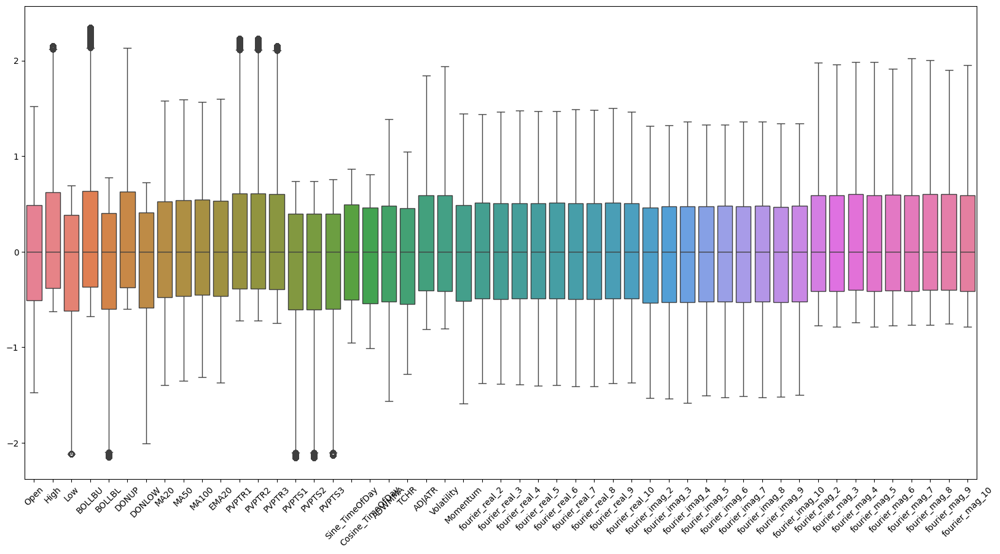

In [51]:
plt.figure(figsize=(20, 10))
sns.boxplot(data=trading_data_scaled[all_training_features])
plt.xticks(rotation=45)
plt.show()

In [52]:
trading_data_scaled.shape[0]

97532

#### Undersample class 1

In [33]:
def resample_data(df, sample_count):
    df_class_0 = df[df['TradeAction'] == 0]
    df_class_1 = df[df['TradeAction'] == 1]
    df_class_2 = df[df['TradeAction'] == 2]

    #Downsample class 1 to 10000
    df_class_1_downsampled = resample(df_class_1, replace=False, n_samples=sample_count, random_state=42)

    df_balanced = pd.concat([df_class_0, df_class_1_downsampled, df_class_2])

    #Shuffle
    df_balanced = df_balanced.sample(frac=1, random_state=42).reset_index(drop=True)
    return df_balanced

In [53]:
trading_data_scaled['Signal'] = trading_data_scaled['Signal'].astype('category')

#### Split the dataset into buy dataset and sell dataset

In [54]:
#### Split the dataset into buy dataset and sell dataset
buy_dataset = trading_data_scaled[(trading_data_scaled['Signal'] == 2) | (trading_data_scaled['Signal'] == 1)]
sell_dataset = trading_data_scaled[(trading_data_scaled['Signal'] == 0) | (trading_data_scaled['Signal'] == 1)]

In [70]:
#### Set signal value to 1 for buy and sell
sell_dataset['Signal'] = sell_dataset['Signal'].map({0: 1, 1: 0})
buy_dataset['Signal'] = buy_dataset['Signal'].map({2: 1, 1: 0})

C:\Users\coool\AppData\Local\Temp\ipykernel_28540\1844941159.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\coool\AppData\Local\Temp\ipykernel_28540\1844941159.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [75]:
sell_dataset['Signal'] = sell_dataset['Signal'].astype('int')
buy_dataset['Signal'] = buy_dataset['Signal'].astype('int')
sell_dataset['Signal'].value_counts()

C:\Users\coool\AppData\Local\Temp\ipykernel_28540\2690437447.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\coool\AppData\Local\Temp\ipykernel_28540\2690437447.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



Signal
0    73862
1    10867
Name: count, dtype: int64

In [76]:
print(f"Buy dataset shape : {buy_dataset.shape} \n Sell dataset shape : {sell_dataset.shape}")

Buy dataset shape : (86665, 81) 
 Sell dataset shape : (84729, 81)


In [77]:
X_buy = buy_dataset[all_training_features]
y_buy = buy_dataset['Signal']
X_sell = sell_dataset[all_training_features]
y_sell = sell_dataset['Signal']

In [78]:

X_train_buy, X_test_buy, y_train_buy, y_test_buy = train_test_split(X_buy, y_buy, test_size=0.2, stratify=buy_dataset['Signal'], random_state=43)
X_train_sell, X_test_sell, y_train_sell, y_test_sell = train_test_split(X_sell, y_sell, test_size=0.2, stratify=sell_dataset['Signal'], random_state=43)


#### Lets Train the Buy model first

In [58]:
print(X_buy.info())

<class 'pandas.core.frame.DataFrame'>
Index: 86665 entries, 0 to 97531
Data columns (total 51 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Open              86665 non-null  float64
 1   High              86665 non-null  float64
 2   Low               86665 non-null  float64
 3   BOLLBU            86665 non-null  float64
 4   BOLLBL            86665 non-null  float64
 5   DONUP             86665 non-null  float64
 6   DONLOW            86665 non-null  float64
 7   MA20              86665 non-null  float64
 8   MA50              86665 non-null  float64
 9   MA100             86665 non-null  float64
 10  EMA20             86665 non-null  float64
 11  PVPTR1            86665 non-null  float64
 12  PVPTR2            86665 non-null  float64
 13  PVPTR3            86665 non-null  float64
 14  PVPTS1            86665 non-null  float64
 15  PVPTS2            86665 non-null  float64
 16  PVPTS3            86665 non-null  float64
 17

In [79]:
#convert data to d matrix to use with xgb
enab_cat = False
dtrain_buy = xgb.DMatrix(X_train_buy, label=y_train_buy )
dtest_buy = xgb.DMatrix(X_test_buy, label=y_test_buy)
dtrain_sell = xgb.DMatrix(X_train_sell, label=y_train_sell )
dtest_sell = xgb.DMatrix(X_test_sell, label=y_test_sell)

In [122]:
X_test_buy.shape

(17333, 51)

In [169]:
num_boosting_rounds = 30000
##### Implement initial training of the model   
learning_rate = 0.01
starting_tree_method = 'approx'
#metric can be mlogloss, auc, merror etc
metric = 'aucpr'

base_params = {
    'objective': 'binary:logistic',
    'eval_metric': metric,
}

params = {
    'tree_method': starting_tree_method
}

params.update(base_params)

##### Define a cosine decay function for Learning Rate to get modified dynamically

In [170]:
class CosineDecayCallback(TrainingCallback):
    def __init__(self, num_rounds, initial_lr, final_lr):
        self.num_rounds = num_rounds
        self.initial_lr = initial_lr
        self.final_lr = final_lr

    def after_iteration(self, model, epoch, evals_log):
        new_lr = self.final_lr + 0.5 * (self.initial_lr - self.final_lr) * (1 + np.cos(np.pi * epoch / self.num_rounds))
        model.set_param('learning_rate', new_lr)
        return False

In [174]:
def custom_score(y_true, y_pred):
    return np.sum((y_true == 1) & (y_pred == 1)) - np.sum((y_true == 0) & (y_pred == 1))

In [178]:
##### CReate the objective function for optuna to tune tree parameters
def objective(trial, BuyOrSell = 'Buy'):
    #print("Point 0")

    # Tune the initial and final learning rate
    initial_lr = trial.suggest_float('initial_lr', 0.01, 0.1, log=True)
    final_lr = trial.suggest_float('final_lr', 0.0001, 0.005, log=True)
    params = {
        'tree_method' : trial.suggest_categorical('tree_method', ['approx', 'hist']) , 
        'gamma': trial.suggest_float('gamma', 1e-2, 10),
        'max_depth': trial.suggest_int('max_depth', 3, 12),
        'min_child_weight': trial.suggest_float('min_child_weight', 0.001, 10),
        'subsample': trial.suggest_float('subsample', 0.1, 1.0),
        'colsample_bytree': trial.suggest_float('colsample_bytree', 0.5, 1.0),
        'lambda': trial.suggest_float('lambda', 0.001, 25), 
        'alpha': trial.suggest_float('alpha', 0.001, 10),
        'learning_rate': initial_lr
    }
    #'scale_pos_weight': trial.suggest_float('scale_pos_weight', min(buying_weight, selling_weight), max(buying_weight, selling_weight))
    params.update(base_params)
    #thresholds = [trial.suggest_float(f'threshold_{i}', 0.1, 0.9) for i in ]
    pruning_callback = optuna.integration.XGBoostPruningCallback(trial, f'test-{metric}')
    evals_result = {}
    #print("Point 1")
    #print(dtrain)
    cosine_decay_callback = CosineDecayCallback(num_boosting_rounds, initial_lr, final_lr)
    if BuyOrSell == 'Buy':
        dtrain = dtrain_buy
        dtest = dtest_buy
        y_test = y_test_buy
        
    else:
        dtrain = dtrain_sell
        dtest = dtest_sell
        y_test = y_test_sell
    xgb_model = xgb.train(params=params, dtrain=dtrain, num_boost_round=num_boosting_rounds, 
                          evals=[(dtest, 'test')],
                          early_stopping_rounds=300,
                          verbose_eval=False,
                          callbacks=[cosine_decay_callback, pruning_callback],
                          evals_result=evals_result
                        )
    #print("Point 2")
    probs = xgb_model.predict(dtest)

    threshold = trial.suggest_float('threshold', 0.01, 0.5)

    preds = (probs > threshold).astype(int)
    

    score = custom_score(y_test, preds)

    #r_score = recall_score(y_test, probs)
    #p_score = precision_score(y_test, probs)
    #print("Point 3")
    print(f"{BuyOrSell} Trial {trial.number}: Best iteration = {xgb_model.best_iteration}, Balance score = {score}")

    return score

In [179]:

study_buy = optuna.create_study(direction='maximize') # for metric auc its maximuze, and for mlogloss its minimie
study_buy.optimize(lambda trial: objective(trial, BuyOrSell='Buy'), n_trials=300)

# Get the best parameters
print(f" Best Buy parameters: {study_buy.best_params}")
print(f" Best Buy Accuracy: {study_buy.best_value}")

[I 2025-03-09 20:03:05,502] A new study created in memory with name: no-name-aa9ae9c3-b0c0-475c-96cc-e8a68108cf85
[I 2025-03-09 20:06:38,892] Trial 0 finished with value: -1124.0 and parameters: {'initial_lr': 0.08086942346980136, 'final_lr': 0.00163884012348355, 'tree_method': 'approx', 'gamma': 0.16581928611425484, 'max_depth': 4, 'min_child_weight': 6.711930803934595, 'subsample': 0.12760081443751708, 'colsample_bytree': 0.7010831040693488, 'lambda': 24.723428257603594, 'alpha': 2.2332478671809888, 'threshold': 0.24141527649667321}. Best is trial 0 with value: -1124.0.


Buy Trial 0: Best iteration = 1641, Balance score = -1124


[W 2025-03-09 20:08:50,661] Trial 1 failed with parameters: {'initial_lr': 0.06140490561228958, 'final_lr': 0.0012460333389608894, 'tree_method': 'approx', 'gamma': 3.363451780476686, 'max_depth': 11, 'min_child_weight': 5.778575681581121, 'subsample': 0.6274997465916603, 'colsample_bytree': 0.7435032597198872, 'lambda': 16.294481438264167, 'alpha': 1.41965632675758} because of the following error: KeyboardInterrupt().
Traceback (most recent call last):
  File "c:\Projects\Trading\Uns_SPY_Trading\venv\Lib\site-packages\optuna\study\_optimize.py", line 197, in _run_trial
    value_or_values = func(trial)
  File "C:\Users\coool\AppData\Local\Temp\ipykernel_28540\2697601315.py", line 2, in <lambda>
    study_buy.optimize(lambda trial: objective(trial, BuyOrSell='Buy'), n_trials=300)
                                     ~~~~~~~~~^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\coool\AppData\Local\Temp\ipykernel_28540\224899376.py", line 36, in objective
    xgb_model = xgb.train(params=params, dt

KeyboardInterrupt: 

In [159]:
best_params = study_buy.best_params
best_score = study_buy.best_value
print(f"Best Buy parameters : {best_params}")
print(f"Best Buy score : {best_score}")
#for trial in study.trials:
#    print(f"Trial {trial.number}: Best iteration = {trial.user_attrs.get('best_iteration')}, best test rmse = {trial.value}")


Best Buy parameters : {'initial_lr': 0.08248344048840575, 'final_lr': 0.0030779889101123737, 'tree_method': 'approx', 'gamma': 0.03196176387821714, 'max_depth': 9, 'min_child_weight': 5.233660943422821, 'subsample': 0.774463686729816, 'colsample_bytree': 0.5576654959304007, 'lambda': 11.376639751384248, 'alpha': 0.32064101948582757}
Best Buy score : 0.53355263773444


In [160]:
params_buy = {}
params_buy.update(base_params)
params_buy.update(best_params)

In [161]:
cosine_decay_callback = CosineDecayCallback(num_boosting_rounds, best_params['initial_lr'], best_params['final_lr'])
final_buy_model = xgb.train(params=params_buy, 
                            dtrain=dtrain_buy, 
                            num_boost_round=num_boosting_rounds, 
                            evals=[(dtest_buy, 'test')], 
                            early_stopping_rounds=300, 
                            verbose_eval=500,
                            callbacks=[cosine_decay_callback])

[0]	test-aucpr:0.27672


c:\Projects\Trading\Uns_SPY_Trading\venv\Lib\site-packages\xgboost\core.py:158: UserWarning:

[11:37:56] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0c55ff5f71b100e98-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "final_lr", "initial_lr" } are not used.




[500]	test-aucpr:0.48442
[1000]	test-aucpr:0.51476
[1500]	test-aucpr:0.52638
[2000]	test-aucpr:0.53104
[2491]	test-aucpr:0.53243


In [162]:
best_buy_y_pred = final_buy_model.predict(dtest_buy)

In [177]:
best_buy_y_pred

array([0.43519986, 0.50771046, 0.07551302, ..., 0.05363655, 0.00218547,
       0.00206551], shape=(17333,), dtype=float32)

#### We try to find the best threshold using optuna

In [145]:
def threshold_objective(trial, y_pred, y_val):
    threshold = trial.suggest_float('threshold', 0.01, 0.5)
    y_thresh = (y_pred > threshold).astype(int)
    score = f1_score(y_val, y_thresh)
    
    return score    

In [163]:
study_threshold_buy = optuna.create_study(direction='maximize') # for metric auc its maximuze, and for mlogloss its minimie
study_threshold_buy.optimize(lambda trial: threshold_objective(trial, best_buy_y_pred, y_test_buy), n_trials=300)

[I 2025-03-09 11:40:57,577] A new study created in memory with name: no-name-aad36822-41b3-441d-9e8b-87c10179115b
[I 2025-03-09 11:40:57,589] Trial 0 finished with value: 0.514083119952728 and parameters: {'threshold': 0.15664255546462588}. Best is trial 0 with value: 0.514083119952728.
[I 2025-03-09 11:40:57,597] Trial 1 finished with value: 0.4696539988655701 and parameters: {'threshold': 0.030639831821591912}. Best is trial 0 with value: 0.514083119952728.
[I 2025-03-09 11:40:57,604] Trial 2 finished with value: 0.41843414506415294 and parameters: {'threshold': 0.33646583380810086}. Best is trial 0 with value: 0.514083119952728.
[I 2025-03-09 11:40:57,611] Trial 3 finished with value: 0.5143769968051118 and parameters: {'threshold': 0.1629609379726981}. Best is trial 3 with value: 0.5143769968051118.
[I 2025-03-09 11:40:57,617] Trial 4 finished with value: 0.4146277295448566 and parameters: {'threshold': 0.3417175307995443}. Best is trial 3 with value: 0.5143769968051118.
[I 2025-03

In [164]:
print(f"Threshold Buy : {study_threshold_buy.best_params}  \n Score : {study_threshold_buy.best_value}")

Threshold Buy : {'threshold': 0.10724732334452922}  
 Score : 0.5239979356614485


In [149]:
#### Save the params and threshold to a file
data_to_save = {
    'params': params_buy,
    'threshold': study_threshold_buy.best_params
}
with open('../Saved_Data/XGBoost AUC/buy_params_auc1min.json', 'w') as f:
    json.dump(data_to_save, f, indent=4)

In [148]:
#### Print classification report for buy model
threshold = study_threshold_buy.best_params['threshold']
y_pred_buy = (best_buy_y_pred > threshold).astype(int)
print(classification_report(y_test_buy, y_pred_buy))

              precision    recall  f1-score   support

           0       0.93      0.88      0.90     14772
           1       0.47      0.59      0.52      2561

    accuracy                           0.84     17333
   macro avg       0.70      0.74      0.71     17333
weighted avg       0.86      0.84      0.85     17333



#### Create model for Sell signals

In [150]:

study_sell = optuna.create_study(direction='maximize') # for metric auc its maximuze, and for mlogloss its minimie
study_sell.optimize(lambda trial: objective(trial, BuyOrSell='Sell'), n_trials=300)


[I 2025-03-09 10:44:35,462] A new study created in memory with name: no-name-a989caa7-feb1-4b43-9b4e-ae271e4108c3
[I 2025-03-09 10:45:07,093] Trial 0 finished with value: 0.2789697770963008 and parameters: {'initial_lr': 0.06777137009637378, 'final_lr': 0.0014697339148693304, 'tree_method': 'approx', 'gamma': 7.65185142649209, 'max_depth': 12, 'min_child_weight': 2.0055847227826806, 'subsample': 0.24751023774002992, 'colsample_bytree': 0.6915087396491357, 'lambda': 19.69079240562035, 'alpha': 9.601674166831694}. Best is trial 0 with value: 0.2789697770963008.


Sell Trial 0: Best iteration = 1192, accuracy score = 0.2789697770963008


[I 2025-03-09 10:45:38,260] Trial 1 finished with value: 0.32448813657240194 and parameters: {'initial_lr': 0.019566433234622625, 'final_lr': 0.0013718024477166484, 'tree_method': 'hist', 'gamma': 2.9616091194331418, 'max_depth': 12, 'min_child_weight': 9.55330720317374, 'subsample': 0.13795138322722159, 'colsample_bytree': 0.8414722918901429, 'lambda': 21.989312057642405, 'alpha': 6.681771371248467}. Best is trial 1 with value: 0.32448813657240194.


Sell Trial 1: Best iteration = 5283, accuracy score = 0.32448813657240194


[I 2025-03-09 10:52:00,745] Trial 2 finished with value: 0.3558779395867959 and parameters: {'initial_lr': 0.04447804520397055, 'final_lr': 0.0005248602336149638, 'tree_method': 'approx', 'gamma': 0.7622641728815427, 'max_depth': 3, 'min_child_weight': 6.251476449774992, 'subsample': 0.6091902824769736, 'colsample_bytree': 0.5124015559670021, 'lambda': 19.84647791764256, 'alpha': 8.306902545155854}. Best is trial 2 with value: 0.3558779395867959.


Sell Trial 2: Best iteration = 11544, accuracy score = 0.3558779395867959


[I 2025-03-09 10:52:22,267] Trial 3 finished with value: 0.38888712506815715 and parameters: {'initial_lr': 0.059739195098328576, 'final_lr': 0.0037757553156850276, 'tree_method': 'hist', 'gamma': 2.211133602936143, 'max_depth': 7, 'min_child_weight': 7.2841138784557815, 'subsample': 0.576315374138071, 'colsample_bytree': 0.659767354959863, 'lambda': 2.747643251955792, 'alpha': 9.511352554233605}. Best is trial 3 with value: 0.38888712506815715.


Sell Trial 3: Best iteration = 2828, accuracy score = 0.38888712506815715


[I 2025-03-09 10:58:34,815] Trial 4 finished with value: 0.39616027841057505 and parameters: {'initial_lr': 0.02980453639045483, 'final_lr': 0.004015878309046632, 'tree_method': 'approx', 'gamma': 2.2485740257847993, 'max_depth': 10, 'min_child_weight': 5.807188967714475, 'subsample': 0.7915997374670822, 'colsample_bytree': 0.7347906307140184, 'lambda': 5.358086581355656, 'alpha': 8.234148982363887}. Best is trial 4 with value: 0.39616027841057505.


Sell Trial 4: Best iteration = 6714, accuracy score = 0.39616027841057505


[I 2025-03-09 10:58:35,396] Trial 5 pruned. Trial was pruned at iteration 3.
[I 2025-03-09 10:59:45,804] Trial 6 pruned. Trial was pruned at iteration 1492.
[I 2025-03-09 11:01:36,902] Trial 7 finished with value: 0.41969909254081417 and parameters: {'initial_lr': 0.07431432647662052, 'final_lr': 0.0018401262819577344, 'tree_method': 'approx', 'gamma': 2.5333508090090584, 'max_depth': 10, 'min_child_weight': 7.297701611806522, 'subsample': 0.5329361148999696, 'colsample_bytree': 0.7001130154890842, 'lambda': 18.040078762202725, 'alpha': 0.009183529740795195}. Best is trial 7 with value: 0.41969909254081417.
[I 2025-03-09 11:01:37,078] Trial 8 pruned. Trial was pruned at iteration 6.


Sell Trial 7: Best iteration = 2128, accuracy score = 0.41969909254081417


[I 2025-03-09 11:01:37,113] Trial 9 pruned. Trial was pruned at iteration 2.
[I 2025-03-09 11:01:37,682] Trial 10 pruned. Trial was pruned at iteration 5.
[I 2025-03-09 11:03:50,542] Trial 11 finished with value: 0.4227361918560691 and parameters: {'initial_lr': 0.09310736924913426, 'final_lr': 0.00468120401204846, 'tree_method': 'approx', 'gamma': 2.1585121454618226, 'max_depth': 10, 'min_child_weight': 7.756262787928835, 'subsample': 0.82947907434645, 'colsample_bytree': 0.6708666599129578, 'lambda': 11.620078486504731, 'alpha': 3.0673460357056976}. Best is trial 11 with value: 0.4227361918560691.


Sell Trial 11: Best iteration = 3207, accuracy score = 0.4227361918560691


[I 2025-03-09 11:03:56,111] Trial 12 pruned. Trial was pruned at iteration 125.
[I 2025-03-09 11:03:56,290] Trial 13 pruned. Trial was pruned at iteration 0.
[I 2025-03-09 11:03:56,786] Trial 14 pruned. Trial was pruned at iteration 4.
[I 2025-03-09 11:04:05,576] Trial 15 pruned. Trial was pruned at iteration 214.
[I 2025-03-09 11:05:30,620] Trial 16 finished with value: 0.397976141221555 and parameters: {'initial_lr': 0.07211074040205102, 'final_lr': 0.00031567237659095327, 'tree_method': 'approx', 'gamma': 3.392265581238482, 'max_depth': 10, 'min_child_weight': 0.9454313559050904, 'subsample': 0.6869877976429881, 'colsample_bytree': 0.7987237898854337, 'lambda': 14.476641215592084, 'alpha': 1.214841064381596}. Best is trial 11 with value: 0.4227361918560691.


Sell Trial 16: Best iteration = 1784, accuracy score = 0.397976141221555


[I 2025-03-09 11:05:31,210] Trial 17 pruned. Trial was pruned at iteration 5.
[I 2025-03-09 11:05:31,344] Trial 18 pruned. Trial was pruned at iteration 0.
[I 2025-03-09 11:05:39,755] Trial 19 pruned. Trial was pruned at iteration 156.
[I 2025-03-09 11:05:40,277] Trial 20 pruned. Trial was pruned at iteration 3.
[I 2025-03-09 11:08:45,690] Trial 21 finished with value: 0.4094539831860695 and parameters: {'initial_lr': 0.07900169280712446, 'final_lr': 0.00036210219957444995, 'tree_method': 'approx', 'gamma': 3.1890936375656467, 'max_depth': 10, 'min_child_weight': 0.4649963836418556, 'subsample': 0.6728946249338204, 'colsample_bytree': 0.7977090198279009, 'lambda': 15.309691835598716, 'alpha': 1.6228318861524837}. Best is trial 11 with value: 0.4227361918560691.


Sell Trial 21: Best iteration = 4521, accuracy score = 0.4094539831860695


[I 2025-03-09 11:10:46,199] Trial 22 finished with value: 0.4191219722034043 and parameters: {'initial_lr': 0.07848973687595552, 'final_lr': 0.00038094993462088687, 'tree_method': 'approx', 'gamma': 2.477366802671727, 'max_depth': 10, 'min_child_weight': 0.7160032070117723, 'subsample': 0.712501714380909, 'colsample_bytree': 0.7044093341513241, 'lambda': 10.408482641163904, 'alpha': 1.4479640310612458}. Best is trial 11 with value: 0.4227361918560691.


Sell Trial 22: Best iteration = 2624, accuracy score = 0.4191219722034043


[I 2025-03-09 11:10:46,445] Trial 23 pruned. Trial was pruned at iteration 0.
[I 2025-03-09 11:10:46,866] Trial 24 pruned. Trial was pruned at iteration 0.
[I 2025-03-09 11:10:47,326] Trial 25 pruned. Trial was pruned at iteration 1.
[I 2025-03-09 11:10:47,849] Trial 26 pruned. Trial was pruned at iteration 0.
[I 2025-03-09 11:10:48,037] Trial 27 pruned. Trial was pruned at iteration 0.
[I 2025-03-09 11:10:49,228] Trial 28 pruned. Trial was pruned at iteration 0.
[I 2025-03-09 11:10:49,547] Trial 29 pruned. Trial was pruned at iteration 0.
[I 2025-03-09 11:10:50,096] Trial 30 pruned. Trial was pruned at iteration 1.
[I 2025-03-09 11:12:58,304] Trial 31 finished with value: 0.4078165100159178 and parameters: {'initial_lr': 0.08290511455379862, 'final_lr': 0.0003692751129089471, 'tree_method': 'approx', 'gamma': 2.9760454507861698, 'max_depth': 10, 'min_child_weight': 0.38201237341490174, 'subsample': 0.649691914019336, 'colsample_bytree': 0.8064427635072805, 'lambda': 15.161538250276013

Sell Trial 31: Best iteration = 2797, accuracy score = 0.4078165100159178


[I 2025-03-09 11:13:10,782] Trial 32 pruned. Trial was pruned at iteration 206.
[I 2025-03-09 11:13:11,011] Trial 33 pruned. Trial was pruned at iteration 0.
[I 2025-03-09 11:13:11,531] Trial 34 pruned. Trial was pruned at iteration 11.
[I 2025-03-09 11:13:12,644] Trial 35 pruned. Trial was pruned at iteration 9.
[I 2025-03-09 11:13:12,925] Trial 36 pruned. Trial was pruned at iteration 2.
[I 2025-03-09 11:13:13,272] Trial 37 pruned. Trial was pruned at iteration 1.
[I 2025-03-09 11:13:13,568] Trial 38 pruned. Trial was pruned at iteration 1.
[I 2025-03-09 11:13:13,727] Trial 39 pruned. Trial was pruned at iteration 0.
[I 2025-03-09 11:13:14,016] Trial 40 pruned. Trial was pruned at iteration 3.
[I 2025-03-09 11:15:48,829] Trial 41 finished with value: 0.4158319022325985 and parameters: {'initial_lr': 0.07850659600666185, 'final_lr': 0.0004127771362339842, 'tree_method': 'approx', 'gamma': 2.9007963788054223, 'max_depth': 10, 'min_child_weight': 0.4226060396301855, 'subsample': 0.65154

Sell Trial 41: Best iteration = 3514, accuracy score = 0.4158319022325985


[I 2025-03-09 11:15:49,391] Trial 42 pruned. Trial was pruned at iteration 2.
[I 2025-03-09 11:15:49,776] Trial 43 pruned. Trial was pruned at iteration 0.
[I 2025-03-09 11:15:50,581] Trial 44 pruned. Trial was pruned at iteration 3.
[I 2025-03-09 11:15:51,021] Trial 45 pruned. Trial was pruned at iteration 1.
[I 2025-03-09 11:15:51,320] Trial 46 pruned. Trial was pruned at iteration 0.
[I 2025-03-09 11:15:52,805] Trial 47 pruned. Trial was pruned at iteration 2.
[I 2025-03-09 11:15:53,301] Trial 48 pruned. Trial was pruned at iteration 0.
[I 2025-03-09 11:15:53,658] Trial 49 pruned. Trial was pruned at iteration 0.
[I 2025-03-09 11:15:53,894] Trial 50 pruned. Trial was pruned at iteration 0.
[I 2025-03-09 11:15:55,390] Trial 51 pruned. Trial was pruned at iteration 10.
[I 2025-03-09 11:15:55,813] Trial 52 pruned. Trial was pruned at iteration 3.
[I 2025-03-09 11:15:56,306] Trial 53 pruned. Trial was pruned at iteration 2.
[I 2025-03-09 11:15:56,480] Trial 54 pruned. Trial was pruned a

Sell Trial 121: Best iteration = 5415, accuracy score = 0.4180876550719812


[I 2025-03-09 11:26:17,285] Trial 122 pruned. Trial was pruned at iteration 45.
[I 2025-03-09 11:26:17,490] Trial 123 pruned. Trial was pruned at iteration 0.
[I 2025-03-09 11:26:17,838] Trial 124 pruned. Trial was pruned at iteration 1.
[I 2025-03-09 11:26:18,008] Trial 125 pruned. Trial was pruned at iteration 0.
[I 2025-03-09 11:26:28,306] Trial 126 pruned. Trial was pruned at iteration 70.
[I 2025-03-09 11:26:28,564] Trial 127 pruned. Trial was pruned at iteration 3.
[I 2025-03-09 11:26:28,828] Trial 128 pruned. Trial was pruned at iteration 1.
[I 2025-03-09 11:26:29,061] Trial 129 pruned. Trial was pruned at iteration 3.
[I 2025-03-09 11:26:29,261] Trial 130 pruned. Trial was pruned at iteration 0.
[I 2025-03-09 11:26:29,850] Trial 131 pruned. Trial was pruned at iteration 3.
[I 2025-03-09 11:26:30,111] Trial 132 pruned. Trial was pruned at iteration 0.
[I 2025-03-09 11:26:30,461] Trial 133 pruned. Trial was pruned at iteration 1.
[I 2025-03-09 11:26:30,711] Trial 134 pruned. Tria

 Best Buy parameters: {'initial_lr': 0.09310736924913426, 'final_lr': 0.00468120401204846, 'tree_method': 'approx', 'gamma': 2.1585121454618226, 'max_depth': 10, 'min_child_weight': 7.756262787928835, 'subsample': 0.82947907434645, 'colsample_bytree': 0.6708666599129578, 'lambda': 11.620078486504731, 'alpha': 3.0673460357056976}
 Best Buy Accuracy: 0.4227361918560691


In [151]:
best_params = study_sell.best_params
best_score = study_sell.best_value
print(f"Best Sell parameters : {best_params}")
print(f"Best Sell score : {best_score}")

Best Sell parameters : {'initial_lr': 0.09310736924913426, 'final_lr': 0.00468120401204846, 'tree_method': 'approx', 'gamma': 2.1585121454618226, 'max_depth': 10, 'min_child_weight': 7.756262787928835, 'subsample': 0.82947907434645, 'colsample_bytree': 0.6708666599129578, 'lambda': 11.620078486504731, 'alpha': 3.0673460357056976}
Best Sell score : 0.4227361918560691


In [152]:
params_sell = {}
params_sell.update(base_params)
params_sell.update(best_params)

In [154]:
cosine_decay_callback = CosineDecayCallback(num_boosting_rounds, best_params['initial_lr'], best_params['final_lr'])
final_sell_model = xgb.train(params=params_sell, 
                            dtrain=dtrain_sell, 
                            num_boost_round=num_boosting_rounds, 
                            evals=[(dtest_sell, 'test')], 
                            early_stopping_rounds=300, 
                            verbose_eval=500,
                            callbacks=[cosine_decay_callback])

[0]	test-aucpr:0.24004


c:\Projects\Trading\Uns_SPY_Trading\venv\Lib\site-packages\xgboost\core.py:158: UserWarning:

[11:33:59] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0c55ff5f71b100e98-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "final_lr", "initial_lr" } are not used.




[500]	test-aucpr:0.38897
[1000]	test-aucpr:0.39612
[1500]	test-aucpr:0.40033
[2000]	test-aucpr:0.40162
[2500]	test-aucpr:0.40307
[3000]	test-aucpr:0.40409
[3500]	test-aucpr:0.40656
[3777]	test-aucpr:0.40655


In [157]:
best_sell_y_pred = final_sell_model.predict(dtest_sell)

In [158]:
study_threshold_sell = optuna.create_study(direction='maximize') # for metric auc its maximuze, and for mlogloss its minimie
study_threshold_sell.optimize(lambda trial: threshold_objective(trial, best_sell_y_pred, y_test_sell), n_trials=300)

[I 2025-03-09 11:37:11,641] A new study created in memory with name: no-name-bfe2b7d5-16c0-4a3a-b152-99cae36cf16e
[I 2025-03-09 11:37:11,667] Trial 0 finished with value: 0.19114219114219114 and parameters: {'threshold': 0.46366145479041204}. Best is trial 0 with value: 0.19114219114219114.
[I 2025-03-09 11:37:11,672] Trial 1 finished with value: 0.16546184738955824 and parameters: {'threshold': 0.49064109181606086}. Best is trial 0 with value: 0.19114219114219114.
[I 2025-03-09 11:37:11,678] Trial 2 finished with value: 0.43652784746613144 and parameters: {'threshold': 0.16736087023620352}. Best is trial 2 with value: 0.43652784746613144.
[I 2025-03-09 11:37:11,683] Trial 3 finished with value: 0.39980580167496055 and parameters: {'threshold': 0.11273670106083984}. Best is trial 2 with value: 0.43652784746613144.
[I 2025-03-09 11:37:11,689] Trial 4 finished with value: 0.20222137112217542 and parameters: {'threshold': 0.45260408480171194}. Best is trial 2 with value: 0.436527847466131

In [165]:
#### Save the params and threshold to a file
data_to_save = {
    'params': params_sell,
    'threshold': study_threshold_sell.best_params
}
with open('../Saved_Data/XGBoost AUC/sell_params_auc1min.json', 'w') as f:
    json.dump(data_to_save, f, indent=4)

#### Update params to use MPS

In [125]:
model_stage2 = xgb.train(params=params, dtrain=dtrain, num_boost_round=num_boosting_rounds, 
                         evals=[(dtest, 'test')], 
                         early_stopping_rounds=50,
                         verbose_eval=500,
                         callbacks=[cosine_decay_callback]
                )

[0]	test-mlogloss:1.07908


/Users/rahuladmin/GIT/Uns_SPY_Trading/venv/lib/python3.13/site-packages/xgboost/core.py:158: UserWarning:

[17:50:31] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "final_lr", "initial_lr" } are not used.




[500]	test-mlogloss:0.95438
[1000]	test-mlogloss:0.90452
[1500]	test-mlogloss:0.86986
[2000]	test-mlogloss:0.84186
[2500]	test-mlogloss:0.82042
[3000]	test-mlogloss:0.80261
[3500]	test-mlogloss:0.78786
[4000]	test-mlogloss:0.77541
[4500]	test-mlogloss:0.76551
[5000]	test-mlogloss:0.75652
[5500]	test-mlogloss:0.74906
[6000]	test-mlogloss:0.74273
[6500]	test-mlogloss:0.73736
[7000]	test-mlogloss:0.73274
[7500]	test-mlogloss:0.72857
[8000]	test-mlogloss:0.72495
[8500]	test-mlogloss:0.72192
[9000]	test-mlogloss:0.71908
[9500]	test-mlogloss:0.71661
[10000]	test-mlogloss:0.71457
[10500]	test-mlogloss:0.71268
[11000]	test-mlogloss:0.71106
[11500]	test-mlogloss:0.70964
[12000]	test-mlogloss:0.70823
[12500]	test-mlogloss:0.70690
[13000]	test-mlogloss:0.70592
[13500]	test-mlogloss:0.70495
[14000]	test-mlogloss:0.70418
[14500]	test-mlogloss:0.70341
[15000]	test-mlogloss:0.70275
[15500]	test-mlogloss:0.70224
[16000]	test-mlogloss:0.70176
[16500]	test-mlogloss:0.70123
[17000]	test-mlogloss:0.70081


In [126]:
model_stage2.best_iteration # got the best iteration from stage 2 training

20389

In [49]:
def learning_rate_decay(epoch):
    return 0.1 * (0.99 ** epoch)

#### Set the num boosting 

In [127]:
num_boosting_rounds = model_stage2.best_iteration
cosine_decay_callback = CosineDecayCallback(num_boosting_rounds, study.best_params['initial_lr'], study.best_params['final_lr'])

In [128]:
import math

def cosine_decay(current_round, num_boost_round):
    initial_lr = 0.2  # Starting learning rate
    final_lr = 0.01  # Minimum learning rate
    return final_lr + (initial_lr - final_lr) * (1 + math.cos(math.pi * current_round / num_boost_round)) / 2


In [129]:
model_final = xgb.train(params=params, 
                        dtrain=dtrain,
                        num_boost_round = num_boosting_rounds,
                        evals=[(dtest, 'test')],
                        callbacks=[cosine_decay_callback],
                        verbose_eval=100)

[0]	test-mlogloss:1.07908


/Users/rahuladmin/GIT/Uns_SPY_Trading/venv/lib/python3.13/site-packages/xgboost/core.py:158: UserWarning:

[18:03:30] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "final_lr", "initial_lr" } are not used.




[100]	test-mlogloss:1.02447
[200]	test-mlogloss:1.00009
[300]	test-mlogloss:0.98209
[400]	test-mlogloss:0.96747
[500]	test-mlogloss:0.95487
[600]	test-mlogloss:0.94329
[700]	test-mlogloss:0.93231
[800]	test-mlogloss:0.92222
[900]	test-mlogloss:0.91318
[1000]	test-mlogloss:0.90513
[1100]	test-mlogloss:0.89733
[1200]	test-mlogloss:0.88998
[1300]	test-mlogloss:0.88323
[1400]	test-mlogloss:0.87653
[1500]	test-mlogloss:0.87033
[1600]	test-mlogloss:0.86450
[1700]	test-mlogloss:0.85862
[1800]	test-mlogloss:0.85276
[1900]	test-mlogloss:0.84801
[2000]	test-mlogloss:0.84322
[2100]	test-mlogloss:0.83855
[2200]	test-mlogloss:0.83415
[2300]	test-mlogloss:0.82982
[2400]	test-mlogloss:0.82596
[2500]	test-mlogloss:0.82227
[2600]	test-mlogloss:0.81854
[2700]	test-mlogloss:0.81479
[2800]	test-mlogloss:0.81099
[2900]	test-mlogloss:0.80754
[3000]	test-mlogloss:0.80404
[3100]	test-mlogloss:0.80069
[3200]	test-mlogloss:0.79777
[3300]	test-mlogloss:0.79461
[3400]	test-mlogloss:0.79192
[3500]	test-mlogloss:0.

In [130]:
y_pred = model_final.predict(dtest)
conf_matrix = confusion_matrix(y_test, y_pred)
conf_df = pd.DataFrame(conf_matrix, columns=['Pred S', 'Pred H', 'Pred B'], index=['Actual S', 'Actual H', 'Actual B'])
print("Condusion Matrix : ")
print(conf_df)
print("Classification Report : ")
print(classification_report(y_test, y_pred))


Condusion Matrix : 
          Pred S  Pred H  Pred B
Actual S    1412     302     167
Actual H     311    1305     384
Actual B     135     322    1468
Classification Report : 
              precision    recall  f1-score   support

           0       0.76      0.75      0.76      1881
           1       0.68      0.65      0.66      2000
           2       0.73      0.76      0.74      1925

    accuracy                           0.72      5806
   macro avg       0.72      0.72      0.72      5806
weighted avg       0.72      0.72      0.72      5806



In [53]:
#model_path = f'../{config['model_save_name']}'
#model_final.save_model(model_path)

In [131]:
new_data_start_date = pd.to_datetime('2024-01-01')
new_data_end_date = pd.to_datetime('2024-03-30')
new_data = all_trading_data[(all_trading_data['Date'] >= new_data_start_date) & (all_trading_data['Date'] <= new_data_end_date)]
new_data = new_data.reset_index(drop=True)

In [148]:
new_data_time_normalized = normalize_timegaps(new_data.copy())
new_data_with_power = calculate_label(new_data_time_normalized)
new_data_with_features = add_new_features_df(new_data_with_power.copy())
new_data_with_features.dropna(inplace=True)
new_data_transformed = transform_features(new_data_with_features.copy())
new_data_scaled = new_data_transformed.copy()
new_data_scaled[all_training_features] = rscaler.transform(new_data_scaled[all_training_features])

#new_data_with_power['']
#new_data_with_features = add_new_features_df(new_data_with_power.copy())



In [149]:
new_data_with_power = new_data_scaled.copy()
action_threshold = 0.5
new_data_with_power['TradeAction'] = np.select(
    [
        new_data_with_power['SellPower'] > action_threshold,
        (new_data_with_power['BuyPower'] == 0) & (new_data_with_power['SellPower'] == 0),
        new_data_with_power['BuyPower'] > action_threshold
    ],
    [0, 1, 2],
    default=3
)

new_data_with_power = new_data_with_power[new_data_with_power['TradeAction'].isin([0,1,2])]
new_data_with_power = new_data_with_power.reset_index(drop=True)

In [150]:
new_data_with_power['TradeAction'].value_counts()

TradeAction
1    7672
2    2027
0    2004
Name: count, dtype: int64

In [151]:
X = new_data_with_power[all_training_features]
y = new_data_with_power['TradeAction']
d_new = xgb.DMatrix(X, label=y)
y_pred = model_final.predict(d_new)

conf_matrix = confusion_matrix(y, y_pred)
conf_df = pd.DataFrame(conf_matrix, columns=['Pred S', 'Pred H', 'Pred B'], index=['Actual S', 'Actual H', 'Actual B'])
print("Condusion Matrix : ")
print(conf_df)
print("Classification Report : ")
print(classification_report(y, y_pred))

Condusion Matrix : 
          Pred S  Pred H  Pred B
Actual S     437     990     577
Actual H    1314    4806    1552
Actual B     539     908     580
Classification Report : 
              precision    recall  f1-score   support

           0       0.19      0.22      0.20      2004
           1       0.72      0.63      0.67      7672
           2       0.21      0.29      0.24      2027

    accuracy                           0.50     11703
   macro avg       0.37      0.38      0.37     11703
weighted avg       0.54      0.50      0.52     11703



In [132]:
new_data.shape

(24180, 7)

In [133]:
bolband_period = config['bolband_period']
donchn_period = config['donchn_period']
max_MA_period = 100
max_EMA_period = 20
tchr_period = config['tchr_period']
adwm_period = config['adwm_period']
atr_period = config['atr_period']
volume_ma_period = config['volume_ma_period']
print(f" Fourier window : {fourier_lookback_window}")
max_window = max(bolband_period, 
                 donchn_period, 
                 max_MA_period, 
                 max_EMA_period,
                 tchr_period,
                 adwm_period,
                 atr_period,
                 volume_ma_period, fourier_lookback_window)
print(f"Max window : {max_window}")


 Fourier window : 100
Max window : 100


In [134]:
def process_data(raw_data, scaler):

    trading_signals = pd.DataFrame(columns=['Date','High', 'Low', 'Open', 'Close', 'TradeSignal', 'Take_Profit_Level'])                   
    # This is the dataframe to which we will be adding the rows live
    historical_data = pd.DataFrame(columns=['Date','High', 'Low', 'Open', 'Close', 'Volume'])
    numeric_columns = ['High', 'Low', 'Open', 'Close', 'Volume'] 
    historical_data[numeric_columns] = historical_data[numeric_columns].apply(pd.to_numeric)
    all_training_features = get_all_training_features()
    predictions = []
    for index,row in raw_data.iterrows():

        if index % 100 == 0:
            logging.info(f'Index : {index}')
        new_row = pd.DataFrame({'Date': [row['Date']], 'High': [row['High']], 'Low': [row['Low']], 'Open': [row['Open']], 'Close': [row['Close']], 'Volume': [row['Volume']]})
        signal_row = pd.DataFrame({'Date': [row['Date']], 'High': [row['High']], 'Low': [row['Low']], 'Open': [row['Open']], 'Close': [row['Close']], 'TradeSignal': [1]})
        trading_signals = pd.concat([trading_signals, signal_row], ignore_index=True)
        historical_data = pd.concat([historical_data, new_row], ignore_index=True)
        historical_data['Volume'] = historical_data['Volume'].astype(int)
        #if len(historical_data) > max_window:
        #    historical_data = historical_data.iloc[-max_window:].reset_index(drop=True)
        if len(historical_data) > max_window:
            #print("Hist data length : ", len(historical_data))
            updated_data = add_new_features_df(historical_data)
            historical_data = historical_data.iloc[-max_window:].reset_index(drop=True)
            #print("Updated data length : ", len(updated_data))
            data_transformed = transform_features(updated_data)
            #print("Data transformed length : ", len(data_transformed))
            #data_transformed = data_transformed.dropna() 
            #data_transformed.reset_index(drop=True, inplace=True)
            inf_features = data_transformed.iloc[-max_window:].reset_index(drop=True)
            #print(f"inf_features shape : {inf_features.shape} and training features : {training_features_upd}")
            #print(inf_features.tail())
            inf_features[all_training_features] = scaler.transform(inf_features[all_training_features])
            last_row_features = inf_features.iloc[[-1]]
            last_row_features = last_row_features[all_training_features]
            if last_row_features.isna().any().any():
                print(f'The inference row at index : {index} contains na')
                print(historical_data[['Volume']].tail())
                break
                continue
        
            last_row_dm = xgb.DMatrix(last_row_features)
            prediction = model_final.predict(last_row_dm)
 
            signal = prediction[0]
            trading_signals.loc[trading_signals.index[-1], 'TradeSignal'] = signal
            trading_signals.loc[trading_signals.index[-1], 'Take_Profit_Level'] = updated_data['Take_Profit_Level'].iloc[-1]
        
    return trading_signals
    

In [135]:
warnings.simplefilter(action='ignore', category=FutureWarning)
warnings.simplefilter(action='ignore', category=pd.errors.PerformanceWarning)

In [136]:
tr_signals = process_data(new_data, rscaler)

In [137]:
def calculate_trade(trading_signals, trade_params):
    trade_positions = []
    #trade_enter_buy = config['trade_enter_buy']
    #trade_enter_sell = config['trade_enter_sell']
    fixed_profit = True
    fixed_profit_value = trade_params['fixed_profit_value']
    trade_enter_buy = trade_params['trade_enter']
    trade_enter_sell = trade_params['trade_enter']
    bar_distance = 60 # in seconds  
    barNo_before_EOD = trade_params['barNo_before_EOD']
    #min_bar_enter_trade_before_EOD = trade_params['min_bar_enter_trade_before_EOD']
    min_bar_enter_trade_before_EOD = 60
    EOD_Time = '16:00'
    trades = []
    balance = 0
    profit_amount = 10
    profit_count = 0
    loss_count = 0
    partial_profit_count = 0
    partial_loss_count = 0
    partial_profit_total = 0
    partial_loss_total = 0
    buy_count = 0
    sell_count = 0
    min_trade_distance = 300
    last_trade_exit = None
    total_trade_length = 0
    #risk = config['risk']
    risk = trade_params['risk']
    loss_amount = profit_amount * risk
    positions = pd.DataFrame(columns=['Entry', 'EntryDate', 'Exit', 'ExitDate', 'Profit', 'Type'])
                    
    for index,row in trading_signals.iterrows():
        tsignal = row['TradeSignal']
        #print(f'Buy Power : {buy_power}, Sell Power : {sell_power}')

        #predicted_class_index = np.argmax(prob_prediction, axis=1)          #predictions.append(prediction[0])
        

        if len(trades) == 0:
            eod_dt_time = row['Date'].replace(hour=int(EOD_Time.split(':')[0]), minute=int(EOD_Time.split(':')[1]))
            latest_trade_enter_time = eod_dt_time - timedelta(seconds=min_bar_enter_trade_before_EOD * bar_distance)
            if last_trade_exit == None or  (row['Date'] - last_trade_exit) > timedelta(seconds=min_trade_distance):
                if row['Date'] <= latest_trade_enter_time: 
                    if tsignal == 2:
                        if fixed_profit:
                            take_profit = fixed_profit_value
                        else:
                            take_profit = row['Take_Profit_Level'] 
                        trades.append({"Type": "B", 
                                    "TakeProfit": row['Close'] + take_profit,
                                    "StopLoss": row['Close'] - (take_profit * config['risk']),
                                    "Profit": take_profit,
                                    "Active": "Y",
                                    'Entry': row['Close'],
                                    'EntryDate': row['Date']
                                    })
                        buy_count += 1
                    elif tsignal == 0:
                        take_profit = row['Take_Profit_Level'] 
                        trades.append({"Type": "S", 
                                    "TakeProfit": row['Close'] - take_profit,
                                    "Profit": take_profit,
                                    "StopLoss": row['Close'] + (take_profit * config['risk']),
                                    "Active": "Y",
                                    'Entry': row['Close'],
                                    'EntryDate': row['Date']
                                    })
                        sell_count += 1
        else:
            trade = trades[0]
            
            eod_dt_time = row['Date'].replace(hour=int(EOD_Time.split(':')[0]), minute=int(EOD_Time.split(':')[1]))
            max_exit_time = eod_dt_time - timedelta(seconds=barNo_before_EOD * bar_distance)
            if row['Date'] >= max_exit_time:
                trade['Active'] = 'N'
                if trade['Type'] == 'B':
                    profit = (row['Close'] - trade['Entry']) * profit_amount
                else:
                    profit = (trade['Entry'] - row['Close']) * profit_amount
                
                if profit < 0:
                    partial_loss_count += 1
                    print(f"EOD Exit , Loss, New Balance : {balance}")
                else:
                    partial_profit_count += 1

                    print(f"EOD Exit, Profit, New Balance : {balance}")
                pos_row = pd.DataFrame({'Entry': [trade['Entry']], 'EntryDate': [trade['EntryDate']], 'Exit': [row['Close']], 'ExitDate': [row['Date']] , 'Profit': profit, 'Type': [trade['Type']]})
                positions = pd.concat([positions, pos_row], ignore_index=True)
                last_trade_exit = row['Date']
                trade_time = (pd.to_datetime(row['Date']) -  pd.to_datetime(trade['EntryDate'])) // pd.Timedelta(minutes=1)
                total_trade_length += trade_time
            else:
                trade_length = (pd.to_datetime(row['Date']) -  pd.to_datetime(trade['EntryDate'])) // pd.Timedelta(minutes=1)
                if tsignal == 2 and trade['Type'] == 'S':
                    trade['Active'] = 'N'
                    profit = (trade['Entry'] - row['Close']) * profit_amount
                    balance += profit 
                    if profit < 0:
                        partial_loss_count += 1
                        partial_loss_total += abs(profit / profit_amount)
                        print(f"Partial Loss, New Balance : {balance}")
                    else:
                        partial_profit_count += 1
                        partial_profit_total += (profit / profit_amount)
                        print(f"Partial Profit, New Balance : {balance}")
                    pos_row = pd.DataFrame({'Entry': [trade['Entry']], 'EntryDate': [trade['EntryDate']], 'Exit': [row['Close']], 'ExitDate': [row['Date']] , 'Profit': profit, 'Type': [trade['Type']]})
                    positions = pd.concat([positions, pos_row], ignore_index=True)
                    last_trade_exit = row['Date']
                    trade_time = (pd.to_datetime(row['Date']) -  pd.to_datetime(trade['EntryDate'])) // pd.Timedelta(minutes=1)
                    total_trade_length += trade_time

                elif tsignal == 0 and trades[0]['Type'] == 'B':
                    trade['Active'] = 'N'
                    profit = (row['Close'] - trade['Entry']) * profit_amount
                    balance += profit
                    if profit < 0:
                        partial_loss_count += 1
                        partial_loss_total += abs(profit / profit_amount)
                        print(f"Partial Loss, New Balance : {balance}")
                    else:
                        partial_profit_count += 1
                        partial_profit_total += (profit / profit_amount)
                        print(f"Partial Profit, New Balance : {balance}")
                    pos_row = pd.DataFrame({'Entry': [trade['Entry']], 'EntryDate': [trade['EntryDate']], 'Exit': [row['Close']], 'ExitDate': [row['Date']] , 'Profit': profit, 'Type': [trade['Type']]})
                    positions = pd.concat([positions, pos_row], ignore_index=True)
                    last_trade_exit = row['Date']
                    trade_time = (pd.to_datetime(row['Date']) -  pd.to_datetime(trade['EntryDate'])) // pd.Timedelta(minutes=1)
                    total_trade_length += trade_time
        
        
        for trade in trades:
            if (trade['Type'] == 'B' and row['High'] >= trade['TakeProfit']) or (trade['Type'] == 'S' and row['Low'] <= trade['TakeProfit']):
                trade['Active'] = 'N'
                balance += (trade['Profit'] * profit_amount)
                profit_count += 1
                print(f"Take Profit, New Balance : {balance}")             
                pos_row = pd.DataFrame({'Entry': [trade['Entry']], 'EntryDate': [trade['EntryDate']], 'Exit': [row['Close']], 'ExitDate': [row['Date']] , 'Profit': (trade['Profit'] * profit_amount), 'Type': [trade['Type']]})
                positions = pd.concat([positions, pos_row], ignore_index=True)
                last_trade_exit = row['Date']
                trade_time = (pd.to_datetime(row['Date']) -  pd.to_datetime(trade['EntryDate'])) // pd.Timedelta(minutes=1)
                total_trade_length += trade_time
            elif (trade['Type'] == 'B' and row['Low'] <= trade['StopLoss']) or (trade['Type'] == 'S' and row['High'] >= trade['StopLoss']):
                trade['Active'] = 'N'
                balance -= (trade['Profit'] * loss_amount)
                loss_count += 1
                print(f"Stop Loss, New Balance : {balance}")
                pos_row = pd.DataFrame({'Entry': [trade['Entry']], 'EntryDate': [trade['EntryDate']], 'Exit': [row['Close']], 'ExitDate': [row['Date']] , 'Profit': (trade['Profit'] * -loss_amount), 'Type': [trade['Type']]})
                positions = pd.concat([positions, pos_row], ignore_index=True)
                last_trade_exit = row['Date']
                trade_time = (pd.to_datetime(row['Date']) -  pd.to_datetime(trade['EntryDate'])) // pd.Timedelta(minutes=1)
                total_trade_length += trade_time


        # Filter out all trades that are not active
        trades = [trade for trade in trades if trade['Active'] == 'Y']
        
    print(f"Final Balance : {balance} \n Take Profit count : {profit_count} \n Stop Loss count : {loss_count} \n Partial Profit count : {partial_profit_count} \n Partial Loss count : {partial_loss_count}")
    print(f"Buy count : {buy_count} \n Sell count : {sell_count}")
    total_trade_count = buy_count + sell_count
    print(f"Average trade length in bars : {total_trade_length / total_trade_count}")
    print(f"Partial Profit Average : {partial_profit_total / partial_profit_count} \n Partial Loss Average : {partial_loss_total / partial_loss_count}")
    
    return positions


In [142]:
trade_params = {
    'fixed_profit_value': 1.0,
    'trade_enter': 0.4,
    'barNo_before_EOD': 20,
    'min_bar_enter_trade_before_EOD': 120,
    'risk': 0.5
}
positions_df = calculate_trade(tr_signals, trade_params)
#tr_signals.tail()

Partial Profit, New Balance : 1.2999999999999545
Partial Profit, New Balance : 2.049999999999841
Partial Profit, New Balance : 3.2490000000001373
Partial Profit, New Balance : 5.554000000000201
Take Profit, New Balance : 18.931364339212724
Partial Loss, New Balance : 17.53136433921286
EOD Exit, Profit, New Balance : 17.53136433921286
Partial Loss, New Balance : 15.93136433921261
Partial Profit, New Balance : 17.231364339213133
Partial Profit, New Balance : 19.631364339212656
Take Profit, New Balance : 29.631364339212656
Partial Loss, New Balance : 26.631364339212542
Partial Profit, New Balance : 29.78136433921252
Partial Profit, New Balance : 34.18136433921249
Partial Loss, New Balance : 29.081364339212584
Partial Profit, New Balance : 29.181364339212493
Partial Loss, New Balance : 28.48136433921256
Partial Profit, New Balance : 29.38136433921288
Stop Loss, New Balance : 24.38136433921288
Take Profit, New Balance : 34.38136433921288
Partial Profit, New Balance : 35.38136433921311
Parti

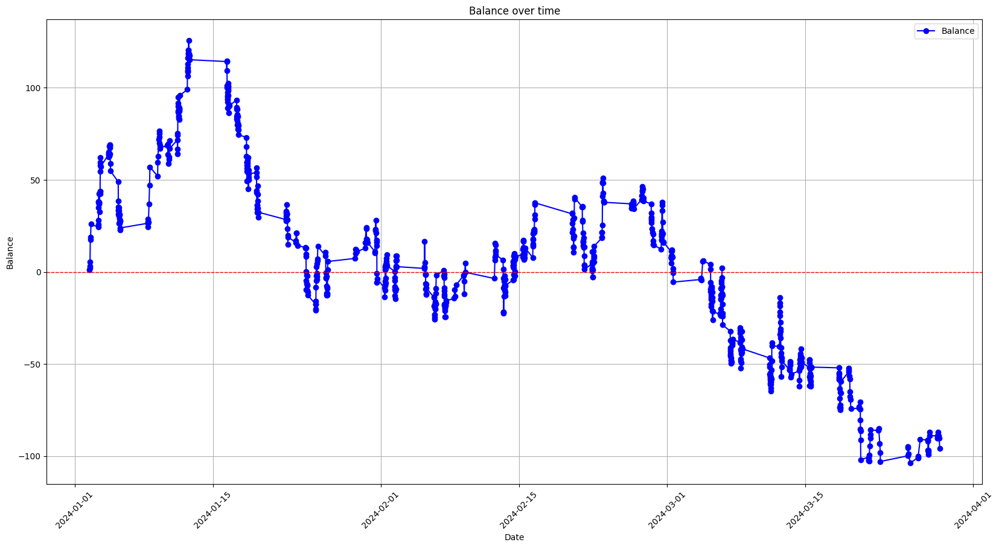

In [143]:
positions_df['ExitDate'] = pd.to_datetime(positions_df['ExitDate'])
positions_df = positions_df.sort_values(by='ExitDate')
positions_df['Balance'] = positions_df['Profit'].cumsum()

plt.figure(figsize=(20, 10))
plt.plot(positions_df['ExitDate'], positions_df['Balance'], marker='o', linestyle='-', color='b', label='Balance')
plt.xlabel('Date')
plt.ylabel('Balance')
plt.title('Balance over time')
plt.axhline(y=0, color='r', linestyle='--', linewidth=1)
plt.legend()
plt.grid(True)
plt.xticks(rotation=45)
plt.show()

In [98]:
def calculate_trade_optuna(trading_signals, trading_params):
    trade_positions = []
    #trade_enter_buy = config['trade_enter_buy']
    #trade_enter_sell = config['trade_enter_sell']
    fixed_profit = True
    fixed_profit_value = trading_params['fixed_profit_value']
    trade_enter_buy = trading_params['trade_enter']
    trade_enter_sell = trading_params['trade_enter']
    bar_distance = 60 # in seconds  
    barNo_before_EOD = trading_params['barNo_before_EOD']
    min_bar_enter_trade_before_EOD = trading_params['min_bar_enter_trade_before_EOD']
    risk = trading_params['risk']
    EOD_Time = '16:00'
    trades = []
    balance = 0
    profit_amount = 10
    profit_count = 0
    loss_count = 0
    partial_profit_count = 0
    partial_loss_count = 0
    buy_count = 0
    sell_count = 0
    loss_amount = profit_amount * risk
    last_trade_exit = None
    min_trade_distance = 300

                    
    for index,row in trading_signals.iterrows():
        buy_power = row['BuyPower']
        sell_power = row['SellPower']
        #print(f'Buy Power : {buy_power}, Sell Power : {sell_power}')

        #predicted_class_index = np.argmax(prob_prediction, axis=1)          #predictions.append(prediction[0])
        

        if len(trades) == 0:
            if last_trade_exit == None or  (row['Date'] - last_trade_exit) > timedelta(seconds=min_trade_distance):
                eod_dt_time = row['Date'].replace(hour=int(EOD_Time.split(':')[0]), minute=int(EOD_Time.split(':')[1]))
                latest_trade_enter_time = eod_dt_time - timedelta(seconds=min_bar_enter_trade_before_EOD * bar_distance)
                
                if row['Date'] <= latest_trade_enter_time: 
                    if buy_power > sell_power and buy_power > trade_enter_buy:
                        if fixed_profit:
                            take_profit = fixed_profit_value
                        else:
                            take_profit = row['Take_Profit_Level'] 
                        trades.append({"Type": "B", 
                                    "TakeProfit": row['Close'] + take_profit,
                                    "StopLoss": row['Close'] - (take_profit * config['risk']),
                                    "Profit": take_profit,
                                    "Active": "Y",
                                    'Entry': row['Close'],
                                    'EntryDate': row['Date']
                                    })
                        buy_count += 1
                    elif sell_power > buy_power and sell_power > trade_enter_sell:
                        take_profit = row['Take_Profit_Level'] 
                        trades.append({"Type": "S", 
                                    "TakeProfit": row['Close'] - take_profit,
                                    "Profit": take_profit,
                                    "StopLoss": row['Close'] + (take_profit * config['risk']),
                                    "Active": "Y",
                                    'Entry': row['Close'],
                                    'EntryDate': row['Date']
                                    })
                        sell_count += 1
        else:
            trade = trades[0]
            eod_dt_time = row['Date'].replace(hour=int(EOD_Time.split(':')[0]), minute=int(EOD_Time.split(':')[1]))
            max_exit_time = eod_dt_time - timedelta(seconds=barNo_before_EOD * bar_distance)
            if row['Date'] >= max_exit_time:
                trade['Active'] = 'N'
                if trade['Type'] == 'B':
                    profit = (row['Close'] - trade['Entry']) * profit_amount
                else:
                    profit = (trade['Entry'] - row['Close']) * profit_amount
                
                if profit < 0:
                    partial_loss_count += 1
                    #print(f"EOD Exit , Loss, New Balance : {balance}")
                else:
                    partial_profit_count += 1
                    #print(f"EOD Exit, Profit, New Balance : {balance}")
                last_trade_exit = row['Date']
            else:
                if buy_power > sell_power and buy_power > trade_enter_buy and trade['Type'] == 'S':
                    trade['Active'] = 'N'
                    profit = (trade['Entry'] - row['Close']) * profit_amount
                    balance += profit 
                    if profit < 0:
                        partial_loss_count += 1
                        #print(f"Partial Loss, New Balance : {balance}")
                    else:
                        partial_profit_count += 1
                        #print(f"Partial Profit, New Balance : {balance}")
                    last_trade_exit = row['Date']

                elif sell_power > buy_power and sell_power > trade_enter_sell and trades[0]['Type'] == 'B':
                    trade['Active'] = 'N'
                    profit = (row['Close'] - trade['Entry']) * profit_amount
                    balance += profit
                    if profit < 0:
                        partial_loss_count += 1
                        #print(f"Partial Loss, New Balance : {balance}")
                    else:
                        partial_profit_count += 1
                        #print(f"Partial Profit, New Balance : {balance}")
                    last_trade_exit = row['Date']
        
        
        for trade in trades:
            if (trade['Type'] == 'B' and row['High'] >= trade['TakeProfit']) or (trade['Type'] == 'S' and row['Low'] <= trade['TakeProfit']):
                trade['Active'] = 'N'
                balance += (trade['Profit'] * profit_amount)
                profit_count += 1
                last_trade_exit = row['Date']
                #print(f"Take Profit, New Balance : {balance}")             
            elif (trade['Type'] == 'B' and row['Low'] <= trade['StopLoss']) or (trade['Type'] == 'S' and row['High'] >= trade['StopLoss']):
                trade['Active'] = 'N'
                balance -= (trade['Profit'] * loss_amount)
                loss_count += 1
                last_trade_exit = row['Date']
                #print(f"Stop Loss, New Balance : {balance}")


        # Filter out all trades that are not active
        trades = [trade for trade in trades if trade['Active'] == 'Y']
    return balance    
    #print(f"Final Balance : {balance} \n Take Profit count : {profit_count} \n Stop Loss count : {loss_count} \n Partial Profit count : {partial_profit_count} \n Partial Loss count : {partial_loss_count}")
    #print(f"Buy count : {buy_count} \n Sell count : {sell_count}")

In [116]:
def trading_objective(trial):
    params = {
        'trade_enter': trial.suggest_float('trade_enter', 0.3, 2.0),
        'fixed_profit_value': trial.suggest_float('fixed_profit_value', 0.4, 4.0),
        'barNo_before_EOD': trial.suggest_int('barNo_before_EOD', 1, 30),
        'min_bar_enter_trade_before_EOD': trial.suggest_int('min_bar_enter_trade_before_EOD', 5, 30),
        'risk': trial.suggest_float('risk', 0.1, 2.0)
    }

    balance = calculate_trade_optuna(tr_signals, params)

    return balance

In [117]:
trading_study = optuna.create_study(direction='maximize') # for metric auc its maximuze, and for mlogloss its minimie
trading_study.optimize(trading_objective, n_trials=200)

[I 2025-03-05 16:16:01,617] A new study created in memory with name: no-name-81993938-1611-4e59-9014-ec2f8d6f0e96
[I 2025-03-05 16:16:02,281] Trial 0 finished with value: -189.57382455835045 and parameters: {'trade_enter': 0.8552395087298419, 'fixed_profit_value': 1.4312603588442006, 'barNo_before_EOD': 23, 'min_bar_enter_trade_before_EOD': 19, 'risk': 1.03938331749996}. Best is trial 0 with value: -189.57382455835045.
[I 2025-03-05 16:16:02,817] Trial 1 finished with value: -126.10400193642336 and parameters: {'trade_enter': 1.310061189953398, 'fixed_profit_value': 1.4595587602516473, 'barNo_before_EOD': 7, 'min_bar_enter_trade_before_EOD': 9, 'risk': 1.4506755048723845}. Best is trial 1 with value: -126.10400193642336.
[I 2025-03-05 16:16:03,332] Trial 2 finished with value: -134.6799271656511 and parameters: {'trade_enter': 1.4198620664734223, 'fixed_profit_value': 0.6566135506819897, 'barNo_before_EOD': 9, 'min_bar_enter_trade_before_EOD': 6, 'risk': 1.8619638321200547}. Best is tr

In [119]:
print(trading_study.best_params)
trading_params_tuned = trading_study.best_params

{'trade_enter': 1.8379569277805503, 'fixed_profit_value': 2.5065575765591293, 'barNo_before_EOD': 25, 'min_bar_enter_trade_before_EOD': 17, 'risk': 1.8818377732556189}


In [118]:
trading_study.best_value

0.0

In [70]:
def calculate_trade_optuna_2values(trading_signals, trading_params):
    trade_positions = []
    #trade_enter_buy = config['trade_enter_buy']
    #trade_enter_sell = config['trade_enter_sell']
    fixed_profit = True
    fixed_profit_value = trading_params['fixed_profit_value']
    trade_enter_buy = trading_params['trade_enter']
    trade_enter_sell = trading_params['trade_enter']
    bar_distance = 60 # in seconds  
    barNo_before_EOD = trading_params['barNo_before_EOD']
    min_bar_enter_trade_before_EOD = trading_params['min_bar_enter_trade_before_EOD']
    risk = trading_params['risk']
    EOD_Time = '16:00'
    trades = []
    balance = 0
    profit_amount = 10
    profit_count = 0
    loss_count = 0
    partial_profit_count = 0
    partial_loss_count = 0
    buy_count = 0
    sell_count = 0
    loss_amount = profit_amount * risk
    total_trade_length = 0
                    
    for index,row in trading_signals.iterrows():
        buy_power = row['BuyPower']
        sell_power = row['SellPower']
        #print(f'Buy Power : {buy_power}, Sell Power : {sell_power}')

        #predicted_class_index = np.argmax(prob_prediction, axis=1)          #predictions.append(prediction[0])
        

        if len(trades) == 0:
            eod_dt_time = row['Date'].replace(hour=int(EOD_Time.split(':')[0]), minute=int(EOD_Time.split(':')[1]))
            latest_trade_enter_time = eod_dt_time - timedelta(seconds=min_bar_enter_trade_before_EOD * bar_distance)
            if row['Date'] <= latest_trade_enter_time: 
                if buy_power > sell_power and buy_power > trade_enter_buy:
                    if fixed_profit:
                        take_profit = fixed_profit_value
                    else:
                        take_profit = row['Take_Profit_Level'] 
                    trades.append({"Type": "B", 
                                "TakeProfit": row['Close'] + take_profit,
                                "StopLoss": row['Close'] - (take_profit * config['risk']),
                                "Profit": take_profit,
                                "Active": "Y",
                                'Entry': row['Close'],
                                'EntryDate': row['Date']
                                })
            
                    buy_count += 1
                elif sell_power > buy_power and sell_power > trade_enter_sell:
                    take_profit = row['Take_Profit_Level'] 
                    trades.append({"Type": "S", 
                                "TakeProfit": row['Close'] - take_profit,
                                "Profit": take_profit,
                                "StopLoss": row['Close'] + (take_profit * config['risk']),
                                "Active": "Y",
                                'Entry': row['Close'],
                                'EntryDate': row['Date']
                                })
                    sell_count += 1
        else:
            trade = trades[0]
            eod_dt_time = row['Date'].replace(hour=int(EOD_Time.split(':')[0]), minute=int(EOD_Time.split(':')[1]))
            max_exit_time = eod_dt_time - timedelta(seconds=barNo_before_EOD * bar_distance)
            if row['Date'] >= max_exit_time:
                trade['Active'] = 'N'
                if trade['Type'] == 'B':
                    profit = (row['Close'] - trade['Entry']) * profit_amount
                else:
                    profit = (trade['Entry'] - row['Close']) * profit_amount
                
                if profit < 0:
                    partial_loss_count += 1
                    #print(f"EOD Exit , Loss, New Balance : {balance}")
                else:
                    partial_profit_count += 1
                    #print(f"EOD Exit, Profit, New Balance : {balance}")
                trade_time = (pd.to_datetime(row['Date']) -  pd.to_datetime(trade['EntryDate'])) // pd.Timedelta(minutes=5)
                total_trade_length += trade_time
            else:
                if buy_power > sell_power and buy_power > trade_enter_buy and trade['Type'] == 'S':
                    trade['Active'] = 'N'
                    profit = (trade['Entry'] - row['Close']) * profit_amount
                    balance += profit 
                    if profit < 0:
                        partial_loss_count += 1
                        #print(f"Partial Loss, New Balance : {balance}")
                    else:
                        partial_profit_count += 1
                        #print(f"Partial Profit, New Balance : {balance}")

                    trade_time = (pd.to_datetime(row['Date']) -  pd.to_datetime(trade['EntryDate'])) // pd.Timedelta(minutes=5)
                    total_trade_length += trade_time

                elif sell_power > buy_power and sell_power > trade_enter_sell and trades[0]['Type'] == 'B':
                    trade['Active'] = 'N'
                    profit = (row['Close'] - trade['Entry']) * profit_amount
                    balance += profit
                    if profit < 0:
                        partial_loss_count += 1
                        #print(f"Partial Loss, New Balance : {balance}")
                    else:
                        partial_profit_count += 1
                        #print(f"Partial Profit, New Balance : {balance}")
                    trade_time = (pd.to_datetime(row['Date']) -  pd.to_datetime(trade['EntryDate'])) // pd.Timedelta(minutes=5)
                    total_trade_length += trade_time
        
        for trade in trades:
            if (trade['Type'] == 'B' and row['High'] >= trade['TakeProfit']) or (trade['Type'] == 'S' and row['Low'] <= trade['TakeProfit']):
                trade['Active'] = 'N'
                balance += (trade['Profit'] * profit_amount)
                profit_count += 1
                #print(f"Take Profit, New Balance : {balance}")  
                trade_time = (pd.to_datetime(row['Date']) -  pd.to_datetime(trade['EntryDate'])) // pd.Timedelta(minutes=5)
                total_trade_length += trade_time           
            elif (trade['Type'] == 'B' and row['Low'] <= trade['StopLoss']) or (trade['Type'] == 'S' and row['High'] >= trade['StopLoss']):
                trade['Active'] = 'N'
                balance -= (trade['Profit'] * loss_amount)
                loss_count += 1
                #print(f"Stop Loss, New Balance : {balance}")
                trade_time = (pd.to_datetime(row['Date']) -  pd.to_datetime(trade['EntryDate'])) // pd.Timedelta(minutes=5)
                total_trade_length += trade_time


        # Filter out all trades that are not active
        trades = [trade for trade in trades if trade['Active'] == 'Y']
    total_trade_count = buy_count + sell_count
    total_loss_count = loss_count + partial_loss_count
    return balance, total_trade_length / total_trade_count   
    #print(f"Final Balance : {balance} \n Take Profit count : {profit_count} \n Stop Loss count : {loss_count} \n Partial Profit count : {partial_profit_count} \n Partial Loss count : {partial_loss_count}")
    #print(f"Buy count : {buy_count} \n Sell count : {sell_count}")

In [73]:
def trading_objective_2(trial):
    params = {
        'trade_enter': trial.suggest_float('trade_enter', 0.2, 2.0),
        'fixed_profit_value': trial.suggest_float('fixed_profit_value', 0.4, 4.0),
        'barNo_before_EOD': trial.suggest_int('barNo_before_EOD', 1, 30),
        'min_bar_enter_trade_before_EOD': trial.suggest_int('min_bar_enter_trade_before_EOD', 5, 30),
        'risk': trial.suggest_float('risk', 0.1, 2.0)
    }

    balance, trade_length = calculate_trade_optuna_2values(tr_signals, params)

    return balance, trade_length

In [74]:
trading_study_2 = optuna.create_study(directions=['maximize', 'minimize']) # for metric auc its maximuze, and for mlogloss its minimie
trading_study_2.optimize(trading_objective_2, n_trials=200)

[I 2025-03-05 14:59:22,903] A new study created in memory with name: no-name-564c1303-d542-4fb9-9ea9-89d3a91dbce6
[I 2025-03-05 14:59:23,417] Trial 0 finished with values: [-398.6217133022649, 11.57857142857143] and parameters: {'trade_enter': 0.5009757874887094, 'fixed_profit_value': 2.508780983135823, 'barNo_before_EOD': 18, 'min_bar_enter_trade_before_EOD': 22, 'risk': 0.9980491836385932}.
[I 2025-03-05 14:59:23,908] Trial 1 finished with values: [-177.53152980149864, 8.119205298013245] and parameters: {'trade_enter': 0.5097916002952668, 'fixed_profit_value': 1.1483498634951403, 'barNo_before_EOD': 13, 'min_bar_enter_trade_before_EOD': 25, 'risk': 0.6786257450834839}.
[I 2025-03-05 14:59:24,420] Trial 2 finished with values: [-1686.7506082165273, 6.884146341463414] and parameters: {'trade_enter': 0.3519562960135584, 'fixed_profit_value': 1.7400696189856424, 'barNo_before_EOD': 4, 'min_bar_enter_trade_before_EOD': 27, 'risk': 1.5654435364427866}.
[I 2025-03-05 14:59:24,916] Trial 3 f

In [75]:
sorted_trials = sorted(trading_study_2.best_trials, key=lambda t: t.values[0], reverse=True)
for trial in sorted_trials:
    print(f"Trial number : {trial.number}, Balance : {trial.values[0]}, Trade Length : {trial.values[1]}")

Trial number : 55, Balance : 831.2336781920219, Trade Length : 2.416065911431514
Trial number : 153, Balance : 831.2336781920219, Trade Length : 2.416065911431514
Trial number : 171, Balance : -680.7393217869685, Trade Length : 2.27705112960761
Trial number : 101, Balance : -1081.700902017323, Trade Length : 1.937888198757764


In [76]:
sorted_trials[0].params

{'trade_enter': 0.2415991569198071,
 'fixed_profit_value': 0.7241734557069652,
 'barNo_before_EOD': 7,
 'min_bar_enter_trade_before_EOD': 6,
 'risk': 0.11947859821788873}

In [ ]:
for trial in trading_study_2.trials:
    print(f"Trial {trial.number}: Best value = {trial.values}")

Trial 0: Best value = [420.80199689188004, 263.0]
Trial 1: Best value = [-49.93553682101156, 3.0]
Trial 2: Best value = [-3.7528638737576046, 290.0]
Trial 3: Best value = [132.07973992854397, 85.0]
Trial 4: Best value = [5.487857695356613, 133.0]
Trial 5: Best value = [92.4904572949738, 24.0]
Trial 6: Best value = [-9.453323356199078, 9.0]
Trial 7: Best value = [-233.67029260752417, 232.0]
Trial 8: Best value = [87.99203310314907, 97.0]
Trial 9: Best value = [-247.3006446033359, 189.0]
Trial 10: Best value = [99.58457331213921, 151.0]
Trial 11: Best value = [869.1926460884704, 599.0]
Trial 12: Best value = [164.44383489905508, 203.0]
Trial 13: Best value = [267.63740176036555, 183.0]
Trial 14: Best value = [-180.32554504400116, 158.0]
Trial 15: Best value = [35.414034673272425, 112.0]
Trial 16: Best value = [-599.0375067879481, 556.0]
Trial 17: Best value = [-30.23947556616759, 67.0]
Trial 18: Best value = [-322.7453503622835, 424.0]
Trial 19: Best value = [-39.54070262477896, 6.0]
Tri

In [108]:
def compute_trade_signal(row):
    trade_enter_buy = 0.5
    trade_enter_sell = 0.5
    if row['BuyPower'] > trade_enter_buy and row['BuyPower'] > row['SellPower']:
        return 'B'
    elif row['SellPower'] > trade_enter_sell and row['SellPower'] > row['BuyPower']:
        return 'S'
    else:
        return 'N'
    
tr_signals['SignalNew'] = tr_signals.apply(compute_trade_signal, axis=1)

In [99]:
buy_signals = tr_signals[tr_signals['Signal'] == 'B']
sell_signals = tr_signals[tr_signals['Signal']== 'S']
trade_to_show = '2024-01-05'
#trading_data['Date'] = pd.to_datetime(trading_data['Date'])
fig = make_subplots(rows=2, cols=1, shared_xaxes=True, 
                    row_heights=[0.7, 0.3], vertical_spacing=0.1,
                    subplot_titles=("CandleStick Chart", "Buy/Sell Signals"))
fig.add_trace(
    go.Candlestick(
        x=tr_signals['Date'], 
        open=tr_signals['Open'], 
        high=tr_signals['High'], 
        low=tr_signals['Low'], 
        close=tr_signals['Close'],
        name='OHLC'
        ), row=1, col=1
)
'''
fig.add_trace(
    go.Scatter(
        x=buy_signals['Date'], 
        y=buy_signals['Low'], 
        mode='markers', 
        name='Buy Signal', 
        marker=dict(color='blue', size=10)))

fig.add_trace(
    go.Scatter(
        x=sell_signals['Date'], 
        y=sell_signals['High'], 
        mode='markers', 
        name='Sell Signal', 
        marker=dict(color='yellow', size=10)))
'''
for index, row in positions_df.iterrows():
    if row['Type'] == 'B':
        entry_symbol = 'triangle-up'
        entry_color = 'blue'
        exit_symbol = 'triangle-down'
        exit_color ='green' if row['Profit'] >= 0 else 'red'
    elif row['Type'] == 'S':
        entry_symbol = 'triangle-down'
        entry_color = 'yellow'
        exit_symbol = 'triangle-up'
        exit_color = 'green' if row['Profit'] >= 0 else 'red'
    
    fig.add_trace(
        go.Scatter(
            x=[row['EntryDate']],
            y=[row['Entry'] + 0.1],
            mode='markers',
            marker=dict(symbol=entry_symbol, size=10, color=entry_color),
            name=f'Entry {row['Type']}'
        ))
    
    fig.add_trace(
        go.Scatter(
            x=[row['ExitDate']],
            y=[row['Exit'] - 0.1],
            mode='markers',
            marker=dict(symbol=exit_symbol, size=10, color=exit_color),
            name=f'Exit {row["Type"]}'
        ))
  
fig.add_trace(
    go.Scatter(
        x=tr_signals['Date'],
        y=tr_signals['BuyPower'],
        mode='lines',
        name='Buy Signal',
        line=dict(color='green', width=2)
    ), row=2, col=1
)

fig.add_trace(
    go.Scatter(
        x=tr_signals['Date'],
        y=tr_signals['SellPower'],
        mode='lines',
        name='Sell Signal',
        line=dict(color='red', width=2)
    ), row=2, col=1
)
  

fig.update_layout(
    title='CandleStick chart with Buy Sell Signals',
    xaxis=dict(type="date", 
               rangebreaks=[
                   dict(bounds=["sat", "mon"]),
                   dict(bounds=[16,9.5], pattern='hour')
               ]              
            ),
    xaxis_rangeslider_visible=False,
    height=600,
    hovermode='x unified'
)



fig.update_xaxes(matches='x')

fig.show()